<a href="https://colab.research.google.com/github/rishubhkhurana/EVA2/blob/master/s5/GAN101.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## GANs
1. DCGAN
2. CGAN
3. ACGAN
4. CycleGAN

## GAN Loss

$$min_Gmax_D[E_{xdata}(log(D(x))+E_{z}(log(1-D(G(z)))]$$

## Pseudo Code(DCGAN)

1. Initialize Generator and Discriminator networks(usually, Convolutional)
2. For e in epochs:
3. Get a batch of real images
4. Get a batch of ranom vector
5. Generate fake images using Generator
6. Compute Discriminator loss as $E_{real}(-log(D(real),real_labels)+E_{fake}(-log(1-D(fake))$
7. Backpropagate through discriminator 
8. Compute Generator loss as $E_{fake}(-log(D(fake)))$


## Importing Libs

In [ ]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.datasets as dsets
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from torchvision.utils import make_grid
from torch.optim import Adam, RMSprop
from torchvision.transforms import Compose,ToTensor,Normalize
from torchsummary import summary
from fastprogress import master_bar,progress_bar
from torch.utils.data import DataLoader

In [ ]:
_optimizers = {'rms':RMSprop,'adam':Adam}

## Dataset loading

In [ ]:
tfms = Compose([ToTensor()])
data = dsets.CIFAR10('./data',download=True,train=True,transform=tfms)

In [ ]:
means = data.data.mean((0,1,2))/255.
stds = data.data.std((0,1,2))/255.

In [ ]:
means,stds

(array([0.49139968, 0.48215841, 0.44653091]),
 array([0.24703223, 0.24348513, 0.26158784]))

In [ ]:
tfms = Compose([ToTensor(),Normalize([0.5]*3,[0.5]*3)])
data = dsets.CIFAR10('./data',download=True,train=True,transform=tfms)

Files already downloaded and verified


In [ ]:
all_data = np.stack([data[i][0].numpy() for i in range(len(data))])

In [ ]:
all_data.std((0,2,3)),all_data.mean((0,2,3)), all_data.min()

In [ ]:
class GANDataLoader:
    def __init__(self,ds,bs=128,**kwargs):
        self.dl = DataLoader(ds,batch_size=bs,**kwargs)
        self.iter = iter(self.dl)
    def get_batch(self):
        try:
            batch = next(self.iter)
        except StopIteration:
            self.iter = iter(self.dl)
            batch = next(self.iter)
        return batch


## Model Design

In [ ]:
class SimpleConvGenerator(nn.Module):
    def __init__(self,in_channels=100,start_channels=256,output_channels=3):
        super().__init__()
        self.ic = in_channels
        sc = start_channels
        self.cblocks = nn.ModuleList()
        self.cblocks.append(nn.Sequential(*[nn.ConvTranspose2d(in_channels,sc,kernel_size=(4,4),stride=(1,1)),nn.BatchNorm2d(sc),nn.ReLU()])) # size of 4
        self.cblocks.append(nn.Sequential(*[nn.ConvTranspose2d(sc,sc//2,kernel_size=(4,4),stride=(2,2),padding=(1,1)),nn.BatchNorm2d(sc//2),nn.ReLU()])) # size of 8
        self.cblocks.append(nn.Sequential(*[nn.ConvTranspose2d(sc//2,sc//4,kernel_size=(4,4),stride=(2,2),padding=(1,1)),nn.BatchNorm2d(sc//4),nn.ReLU()])) # size of 16
        self.cblocks.append(nn.Sequential(*[nn.ConvTranspose2d(sc//4,output_channels,kernel_size=(4,4),stride=(2,2),padding=(1,1)),nn.Tanh()])) # size of 32
    
    def forward(self,x):
        bs = x.shape[0]
        x = x.view(bs,self.ic,1,1)
        for lyr in self.cblocks:
            x = lyr(x)
        return x

In [ ]:
class SimpleConvDiscriminator(nn.Module):
    def __init__(self,in_channels=3,start_channels=64):
        super().__init__()
        self.in_channels = in_channels
        sc = start_channels
        self.cblocks = nn.ModuleList()
        self.cblocks.append(nn.Sequential(*[nn.Conv2d(3,sc,kernel_size=(4,4),stride=(2,2),padding=(1,1)),nn.LeakyReLU(0.2,inplace=True)]))# 16
        self.cblocks.append(nn.Sequential(*[nn.Conv2d(sc,sc*2,kernel_size=(4,4),stride=(2,2),padding=(1,1)),nn.LeakyReLU(0.2,inplace=True)]))# 8
        self.cblocks.append(nn.Sequential(*[nn.Conv2d(sc*2,sc*4,kernel_size=(4,4),stride=(2,2),padding=(1,1)),nn.LeakyReLU(0.2,inplace=True)]))# 4
        self.cblocks.append(nn.Sequential(*[nn.Conv2d(sc*4,1,kernel_size=(4,4),stride=(1,1)),nn.Sigmoid()]))# 1

    def forward(self,x):
        for lyr in self.cblocks:
            x = lyr(x)
        return x.view(-1,)


In [ ]:
gen = SimpleConvGenerator().cuda()
disc = SimpleConvDiscriminator().cuda()

In [ ]:
summary(gen,(100,))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 256, 4, 4]         409,856
       BatchNorm2d-2            [-1, 256, 4, 4]             512
              ReLU-3            [-1, 256, 4, 4]               0
   ConvTranspose2d-4            [-1, 128, 8, 8]         524,416
       BatchNorm2d-5            [-1, 128, 8, 8]             256
              ReLU-6            [-1, 128, 8, 8]               0
   ConvTranspose2d-7           [-1, 64, 16, 16]         131,136
       BatchNorm2d-8           [-1, 64, 16, 16]             128
              ReLU-9           [-1, 64, 16, 16]               0
  ConvTranspose2d-10            [-1, 3, 32, 32]           3,075
             Tanh-11            [-1, 3, 32, 32]               0
Total params: 1,069,379
Trainable params: 1,069,379
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forw

In [ ]:
summary(disc,(3,32,32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 16, 16]           3,136
         LeakyReLU-2           [-1, 64, 16, 16]               0
            Conv2d-3            [-1, 128, 8, 8]         131,200
         LeakyReLU-4            [-1, 128, 8, 8]               0
            Conv2d-5            [-1, 256, 4, 4]         524,544
         LeakyReLU-6            [-1, 256, 4, 4]               0
            Conv2d-7              [-1, 1, 1, 1]           4,097
           Sigmoid-8              [-1, 1, 1, 1]               0
Total params: 662,977
Trainable params: 662,977
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.01
Forward/backward pass size (MB): 0.44
Params size (MB): 2.53
Estimated Total Size (MB): 2.98
----------------------------------------------------------------


## Loss Trackers

In [ ]:
class GenTracker:
    def __init__(self):
        self.reset()
    def reset(self):
        self.losses=[]
        self.iters=0
        self.accuracies=[]
    def update(self,loss,accuracy):
        self.losses.append(loss)
        self.accuracies.append(accuracy)
        self.iters+=1

In [ ]:
class DiscTracker:
    def __init__(self):
        self.reset()
    def reset(self):
        self.losses=[]
        self.iters=0
        self.accuracies=[]
        self.faccuracies = []
        self.raccuracies = []
        self.flosses = []
        self.rlosses=[]


    def update(self,rloss,floss,racc,facc):
        self.flosses.append(floss)
        self.rlosses.append(rloss)
        self.raccuracies.append(racc)
        self.faccuracies.append(facc)
        self.accuracies.append((racc+facc)/2.)
        self.losses.append((rloss+floss)/2.)
        self.iters+=1


## Training Loop

In [ ]:
#basic settings
N_EPOCHS = 100
BATCH_SIZE = 100
optim_type = 'adam'
d=100
optimizer = _optimizers[optim_type]
z = torch.randn((16,d))
criterion = nn.BCELoss()
real_labels = torch.ones(BATCH_SIZE)
fake_labels = torch.zeros(BATCH_SIZE)
real_dl = GANDataLoader(data,bs=BATCH_SIZE,shuffle=True,pin_memory=True,num_workers=2)
gen_model = SimpleConvGenerator().cuda()
disc_model = SimpleConvDiscriminator().cuda()
models=[gen_model,disc_model]
opts = [optimizer(gen_model.parameters(),lr=2e-4,betas=(0.5,0.999)),optimizer(disc_model.parameters(),lr=2e-4,betas=(0.5,0.999))]
trackers = [GenTracker(),DiscTracker()]

In [ ]:
def one_iter(models,opts,trackers,real_batch,criterion=nn.BCELoss(),bs=BATCH_SIZE,device='cuda',mb=None):
    gen_model=models[0]
    disc_model=models[1]
    gen_model.train()
    disc_model.train()
    gen_opt = opts[0]
    disc_opt = opts[1]
    gen_tracker = trackers[0]
    disc_tracker = trackers[1]
    # get the random noise
    rvs = torch.randn((bs,d)).to(device)
    #### Discriminator ####
    disc_opt.zero_grad()
    # get real images 
    xreal,_ = real_batch
    # get discriminator prediction on real batch
    rpreds = disc_model(xreal.to(device))
    # compute real loss
    rloss = criterion(rpreds,real_labels.to(device))
    # get fake images
    xfake = gen_model(rvs)
    # compute fake loss
    fpreds = disc_model(xfake.detach().to(device))
    floss = criterion(fpreds,fake_labels.to(device))
    # update discriminator
    tloss = 0.5*(rloss+floss)
    tloss.backward()
    disc_opt.step()
    # track the disc
    racc = ((rpreds.detach().cpu()>0.5).long()==real_labels.long()).float().mean()
    facc = ((fpreds.detach().cpu()>0.5).long()==fake_labels.long()).float().mean()
    disc_tracker.update(rloss.item(),floss.item(),racc.item(),facc.item())
    ##### Generator #####
    gen_opt.zero_grad()
    fpreds = disc_model(xfake.to(device))
    gloss = criterion(fpreds,real_labels.to(device))
    gloss.backward()
    gen_opt.step()
    gacc = ((fpreds.detach().cpu()>0.5).long()==real_labels.long()).float().mean()
    gen_tracker.update(gloss.item(),gacc.item())
    if mb is not None:
        mb.main_bar.comment=f'Discriminator Loss: {tloss}, Generator Loss: {gloss}'

In [ ]:
def trainGAN(models,opts,trackers,real_dl,fixed_noise=None,n_iters=30000,n=100,criterion=nn.BCELoss(),bs=BATCH_SIZE,device='cuda'):
    iters_epoch = len(real_dl.dl)
    mb = master_bar(range(n_iters),total=n_iters)
    pb = progress_bar(range(n_iters),total=n_iters)
    for it in pb:
        batch = real_dl.get_batch()
        if batch[0].shape[0]<bs:
            batch = real_dl.get_batch()
        # walk through one iteration
        one_iter(models, opts, trackers, batch,bs=bs,device=device,criterion=criterion,mb=None)
        if it%iters_epoch ==0:
            n=-100
            epoch = it//iters_epoch
            content = f"Num Iters: {it} -- "
            content+=f"Discriminator--> Total Loss: {np.mean(trackers[1].losses[-100:]):.3f}, Real Loss: {np.mean(trackers[1].rlosses[-100:]):.3f}, Fake Loss: {np.mean(trackers[1].flosses[-100:]):.3f}, Real Accuracy: {np.mean(trackers[1].raccuracies[-100:]):.3f}, Fake accuracy: {np.mean(trackers[1].faccuracies[-100:]):.3f}\n"
            content+=f"Generator--> Total Loss: {np.mean(trackers[0].losses[-100:]):.3f}, Accuracy: {np.mean(trackers[0].accuracies[-100:]):.3f}\n"
            print(content)
            if fixed_noise is not None:
                gen_model.eval()
                images = gen_model(fixed_noise.to(device))
                imgrid = make_grid(images,nrow=4,normalize=True)
                imgrid = imgrid.detach().cpu().numpy().transpose((1,2,0))
                plt.imshow(imgrid)
                _=plt.show()




        
    

Num Iters: 0 -- Discriminator--> Total Loss: 0.693, Real Loss: 0.699, Fake Loss: 0.686, Real Accuracy: 0.150, Fake accuracy: 0.850
Generator--> Total Loss: 0.748, Accuracy: 0.000



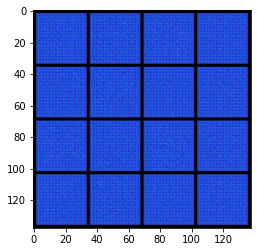

Num Iters: 500 -- Discriminator--> Total Loss: 0.663, Real Loss: 0.690, Fake Loss: 0.637, Real Accuracy: 0.544, Fake accuracy: 0.672
Generator--> Total Loss: 1.013, Accuracy: 0.079



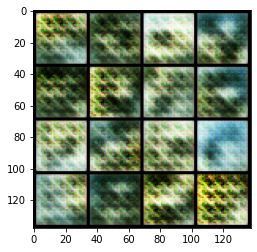

Num Iters: 1000 -- Discriminator--> Total Loss: 0.662, Real Loss: 0.679, Fake Loss: 0.645, Real Accuracy: 0.533, Fake accuracy: 0.663
Generator--> Total Loss: 0.964, Accuracy: 0.125



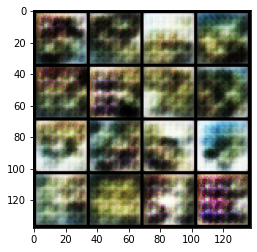

Num Iters: 1500 -- Discriminator--> Total Loss: 0.628, Real Loss: 0.641, Fake Loss: 0.615, Real Accuracy: 0.593, Fake accuracy: 0.724
Generator--> Total Loss: 1.034, Accuracy: 0.080



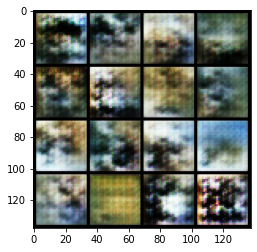

Num Iters: 2000 -- Discriminator--> Total Loss: 0.637, Real Loss: 0.651, Fake Loss: 0.622, Real Accuracy: 0.560, Fake accuracy: 0.728
Generator--> Total Loss: 1.024, Accuracy: 0.063



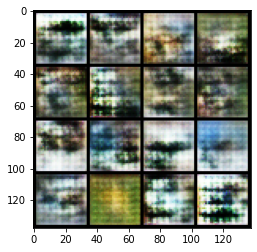

Num Iters: 2500 -- Discriminator--> Total Loss: 0.635, Real Loss: 0.650, Fake Loss: 0.620, Real Accuracy: 0.552, Fake accuracy: 0.723
Generator--> Total Loss: 0.953, Accuracy: 0.107



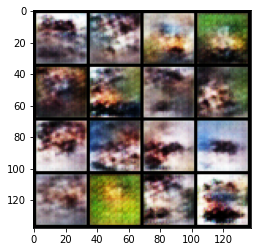

Num Iters: 3000 -- Discriminator--> Total Loss: 0.623, Real Loss: 0.645, Fake Loss: 0.602, Real Accuracy: 0.553, Fake accuracy: 0.764
Generator--> Total Loss: 1.023, Accuracy: 0.080



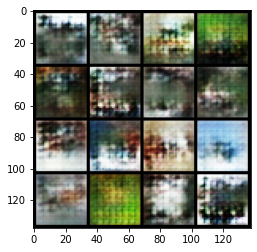

Num Iters: 3500 -- Discriminator--> Total Loss: 0.595, Real Loss: 0.617, Fake Loss: 0.572, Real Accuracy: 0.574, Fake accuracy: 0.789
Generator--> Total Loss: 1.119, Accuracy: 0.075



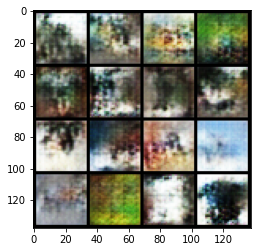

Num Iters: 4000 -- Discriminator--> Total Loss: 0.568, Real Loss: 0.594, Fake Loss: 0.543, Real Accuracy: 0.585, Fake accuracy: 0.822
Generator--> Total Loss: 1.180, Accuracy: 0.061



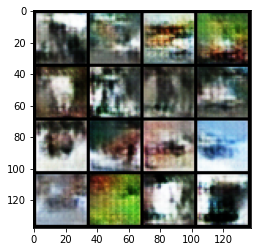

Num Iters: 4500 -- Discriminator--> Total Loss: 0.549, Real Loss: 0.573, Fake Loss: 0.526, Real Accuracy: 0.610, Fake accuracy: 0.829
Generator--> Total Loss: 1.209, Accuracy: 0.062



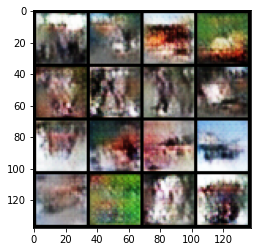

Num Iters: 5000 -- Discriminator--> Total Loss: 0.552, Real Loss: 0.581, Fake Loss: 0.524, Real Accuracy: 0.600, Fake accuracy: 0.839
Generator--> Total Loss: 1.206, Accuracy: 0.071



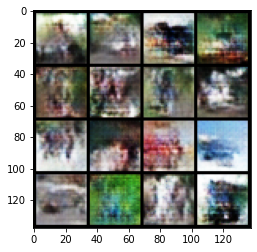

Num Iters: 5500 -- Discriminator--> Total Loss: 0.530, Real Loss: 0.563, Fake Loss: 0.497, Real Accuracy: 0.611, Fake accuracy: 0.856
Generator--> Total Loss: 1.241, Accuracy: 0.062



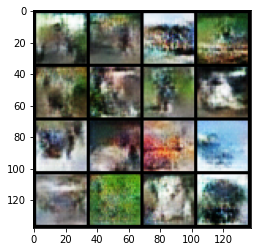

Num Iters: 6000 -- Discriminator--> Total Loss: 0.548, Real Loss: 0.578, Fake Loss: 0.518, Real Accuracy: 0.593, Fake accuracy: 0.837
Generator--> Total Loss: 1.202, Accuracy: 0.073



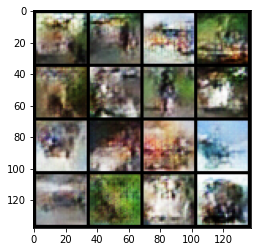

Num Iters: 6500 -- Discriminator--> Total Loss: 0.544, Real Loss: 0.571, Fake Loss: 0.517, Real Accuracy: 0.597, Fake accuracy: 0.843
Generator--> Total Loss: 1.223, Accuracy: 0.065



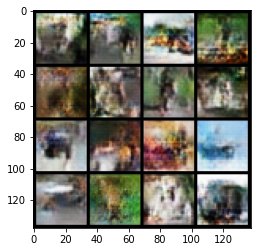

Num Iters: 7000 -- Discriminator--> Total Loss: 0.535, Real Loss: 0.566, Fake Loss: 0.504, Real Accuracy: 0.597, Fake accuracy: 0.850
Generator--> Total Loss: 1.227, Accuracy: 0.065



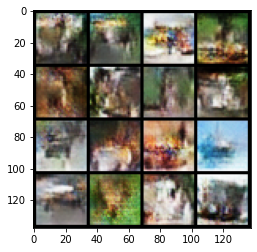

Num Iters: 7500 -- Discriminator--> Total Loss: 0.537, Real Loss: 0.568, Fake Loss: 0.507, Real Accuracy: 0.603, Fake accuracy: 0.848
Generator--> Total Loss: 1.220, Accuracy: 0.063



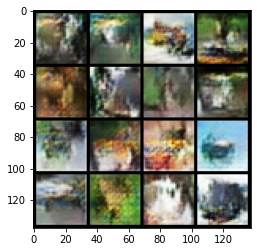

Num Iters: 8000 -- Discriminator--> Total Loss: 0.546, Real Loss: 0.578, Fake Loss: 0.515, Real Accuracy: 0.588, Fake accuracy: 0.848
Generator--> Total Loss: 1.184, Accuracy: 0.067



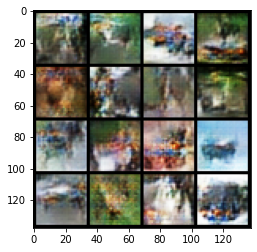

Num Iters: 8500 -- Discriminator--> Total Loss: 0.549, Real Loss: 0.578, Fake Loss: 0.519, Real Accuracy: 0.599, Fake accuracy: 0.842
Generator--> Total Loss: 1.218, Accuracy: 0.072



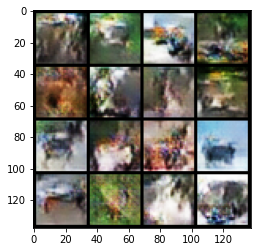

Num Iters: 9000 -- Discriminator--> Total Loss: 0.544, Real Loss: 0.574, Fake Loss: 0.513, Real Accuracy: 0.596, Fake accuracy: 0.843
Generator--> Total Loss: 1.263, Accuracy: 0.054



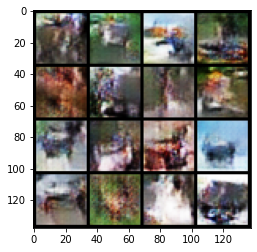

Num Iters: 9500 -- Discriminator--> Total Loss: 0.560, Real Loss: 0.593, Fake Loss: 0.527, Real Accuracy: 0.598, Fake accuracy: 0.827
Generator--> Total Loss: 1.236, Accuracy: 0.071



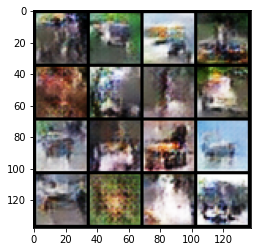

Num Iters: 10000 -- Discriminator--> Total Loss: 0.535, Real Loss: 0.567, Fake Loss: 0.504, Real Accuracy: 0.606, Fake accuracy: 0.853
Generator--> Total Loss: 1.246, Accuracy: 0.058



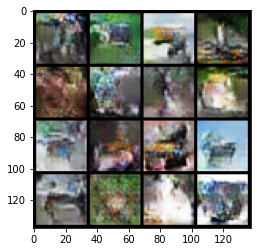

Num Iters: 10500 -- Discriminator--> Total Loss: 0.542, Real Loss: 0.571, Fake Loss: 0.513, Real Accuracy: 0.603, Fake accuracy: 0.842
Generator--> Total Loss: 1.222, Accuracy: 0.065



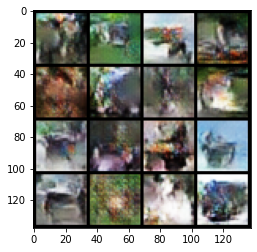

Num Iters: 11000 -- Discriminator--> Total Loss: 0.533, Real Loss: 0.561, Fake Loss: 0.505, Real Accuracy: 0.613, Fake accuracy: 0.851
Generator--> Total Loss: 1.223, Accuracy: 0.057



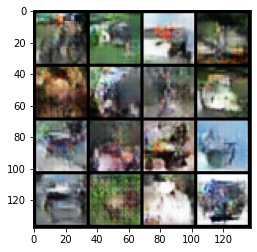

Num Iters: 11500 -- Discriminator--> Total Loss: 0.553, Real Loss: 0.580, Fake Loss: 0.527, Real Accuracy: 0.608, Fake accuracy: 0.822
Generator--> Total Loss: 1.241, Accuracy: 0.087



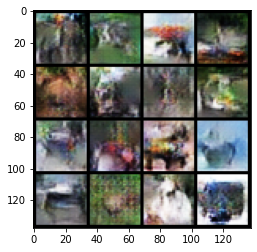

Num Iters: 12000 -- Discriminator--> Total Loss: 0.538, Real Loss: 0.569, Fake Loss: 0.507, Real Accuracy: 0.615, Fake accuracy: 0.839
Generator--> Total Loss: 1.254, Accuracy: 0.069



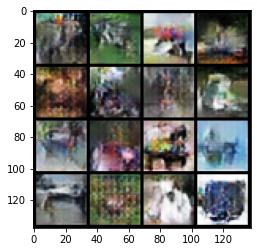

Num Iters: 12500 -- Discriminator--> Total Loss: 0.547, Real Loss: 0.575, Fake Loss: 0.520, Real Accuracy: 0.604, Fake accuracy: 0.835
Generator--> Total Loss: 1.194, Accuracy: 0.081



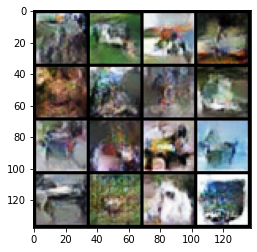

Num Iters: 13000 -- Discriminator--> Total Loss: 0.537, Real Loss: 0.564, Fake Loss: 0.510, Real Accuracy: 0.608, Fake accuracy: 0.848
Generator--> Total Loss: 1.169, Accuracy: 0.072



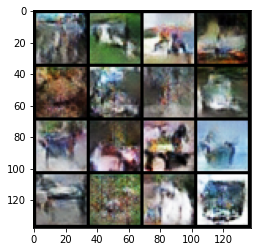

Num Iters: 13500 -- Discriminator--> Total Loss: 0.548, Real Loss: 0.573, Fake Loss: 0.522, Real Accuracy: 0.608, Fake accuracy: 0.833
Generator--> Total Loss: 1.152, Accuracy: 0.078



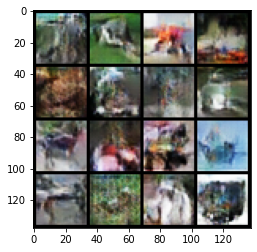

Num Iters: 14000 -- Discriminator--> Total Loss: 0.548, Real Loss: 0.575, Fake Loss: 0.521, Real Accuracy: 0.604, Fake accuracy: 0.835
Generator--> Total Loss: 1.185, Accuracy: 0.085



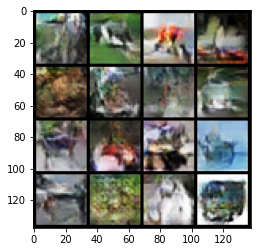

Num Iters: 14500 -- Discriminator--> Total Loss: 0.543, Real Loss: 0.567, Fake Loss: 0.518, Real Accuracy: 0.610, Fake accuracy: 0.834
Generator--> Total Loss: 1.171, Accuracy: 0.087



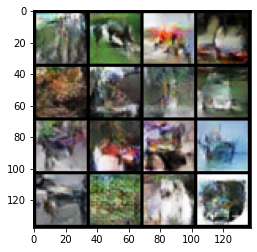

Num Iters: 15000 -- Discriminator--> Total Loss: 0.545, Real Loss: 0.572, Fake Loss: 0.518, Real Accuracy: 0.606, Fake accuracy: 0.834
Generator--> Total Loss: 1.166, Accuracy: 0.082



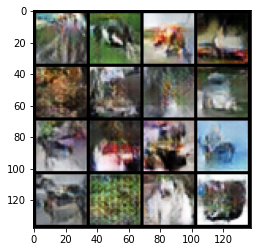

Num Iters: 15500 -- Discriminator--> Total Loss: 0.570, Real Loss: 0.588, Fake Loss: 0.552, Real Accuracy: 0.601, Fake accuracy: 0.811
Generator--> Total Loss: 1.153, Accuracy: 0.099



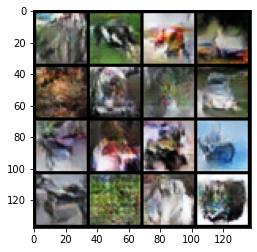

Num Iters: 16000 -- Discriminator--> Total Loss: 0.553, Real Loss: 0.580, Fake Loss: 0.527, Real Accuracy: 0.607, Fake accuracy: 0.826
Generator--> Total Loss: 1.192, Accuracy: 0.083



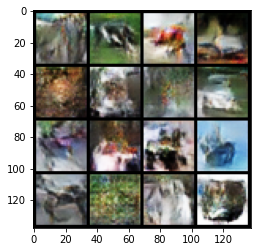

Num Iters: 16500 -- Discriminator--> Total Loss: 0.550, Real Loss: 0.575, Fake Loss: 0.525, Real Accuracy: 0.609, Fake accuracy: 0.832
Generator--> Total Loss: 1.171, Accuracy: 0.086



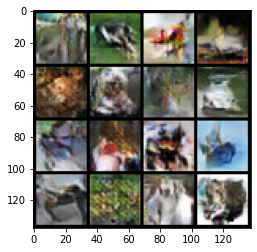

Num Iters: 17000 -- Discriminator--> Total Loss: 0.552, Real Loss: 0.575, Fake Loss: 0.530, Real Accuracy: 0.611, Fake accuracy: 0.822
Generator--> Total Loss: 1.217, Accuracy: 0.080



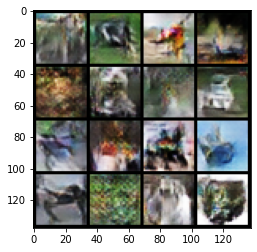

Num Iters: 17500 -- Discriminator--> Total Loss: 0.539, Real Loss: 0.564, Fake Loss: 0.513, Real Accuracy: 0.616, Fake accuracy: 0.839
Generator--> Total Loss: 1.157, Accuracy: 0.088



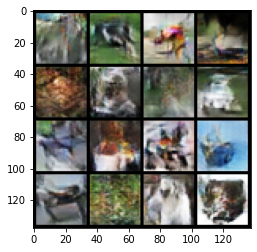

Num Iters: 18000 -- Discriminator--> Total Loss: 0.537, Real Loss: 0.563, Fake Loss: 0.511, Real Accuracy: 0.614, Fake accuracy: 0.841
Generator--> Total Loss: 1.152, Accuracy: 0.082



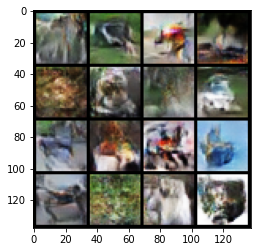

Num Iters: 18500 -- Discriminator--> Total Loss: 0.541, Real Loss: 0.565, Fake Loss: 0.517, Real Accuracy: 0.614, Fake accuracy: 0.835
Generator--> Total Loss: 1.163, Accuracy: 0.084



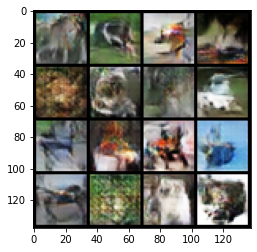

Num Iters: 19000 -- Discriminator--> Total Loss: 0.574, Real Loss: 0.594, Fake Loss: 0.554, Real Accuracy: 0.604, Fake accuracy: 0.802
Generator--> Total Loss: 1.172, Accuracy: 0.105



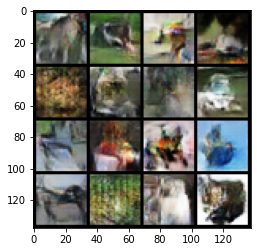

Num Iters: 19500 -- Discriminator--> Total Loss: 0.545, Real Loss: 0.569, Fake Loss: 0.520, Real Accuracy: 0.606, Fake accuracy: 0.831
Generator--> Total Loss: 1.149, Accuracy: 0.080



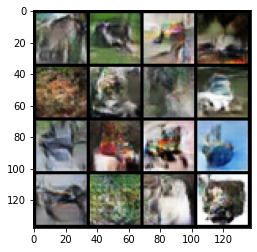

Num Iters: 20000 -- Discriminator--> Total Loss: 0.533, Real Loss: 0.558, Fake Loss: 0.508, Real Accuracy: 0.629, Fake accuracy: 0.833
Generator--> Total Loss: 1.212, Accuracy: 0.083



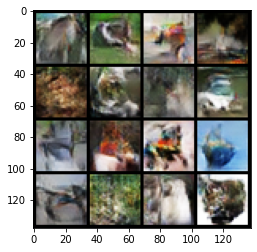

Num Iters: 20500 -- Discriminator--> Total Loss: 0.536, Real Loss: 0.561, Fake Loss: 0.511, Real Accuracy: 0.627, Fake accuracy: 0.831
Generator--> Total Loss: 1.190, Accuracy: 0.084



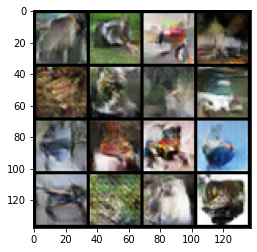

Num Iters: 21000 -- Discriminator--> Total Loss: 0.561, Real Loss: 0.581, Fake Loss: 0.541, Real Accuracy: 0.613, Fake accuracy: 0.797
Generator--> Total Loss: 1.167, Accuracy: 0.115



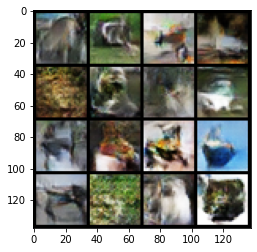

Num Iters: 21500 -- Discriminator--> Total Loss: 0.539, Real Loss: 0.564, Fake Loss: 0.514, Real Accuracy: 0.625, Fake accuracy: 0.831
Generator--> Total Loss: 1.195, Accuracy: 0.083



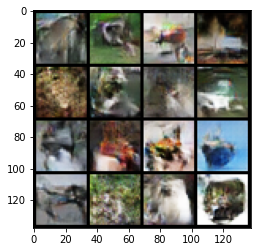

Num Iters: 22000 -- Discriminator--> Total Loss: 0.535, Real Loss: 0.559, Fake Loss: 0.511, Real Accuracy: 0.628, Fake accuracy: 0.834
Generator--> Total Loss: 1.196, Accuracy: 0.085



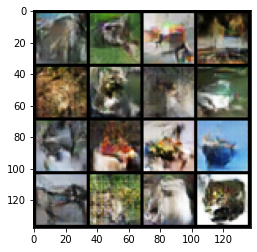

Num Iters: 22500 -- Discriminator--> Total Loss: 0.524, Real Loss: 0.548, Fake Loss: 0.500, Real Accuracy: 0.641, Fake accuracy: 0.839
Generator--> Total Loss: 1.231, Accuracy: 0.080



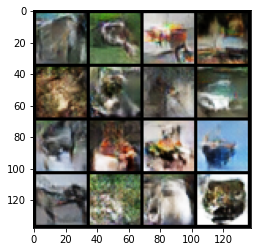

Num Iters: 23000 -- Discriminator--> Total Loss: 0.522, Real Loss: 0.547, Fake Loss: 0.497, Real Accuracy: 0.639, Fake accuracy: 0.840
Generator--> Total Loss: 1.214, Accuracy: 0.079



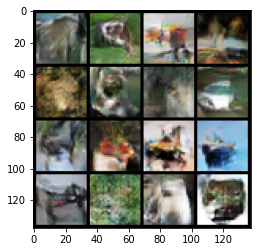

Num Iters: 23500 -- Discriminator--> Total Loss: 0.538, Real Loss: 0.558, Fake Loss: 0.517, Real Accuracy: 0.640, Fake accuracy: 0.817
Generator--> Total Loss: 1.226, Accuracy: 0.093



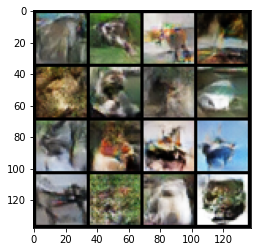

Num Iters: 24000 -- Discriminator--> Total Loss: 0.534, Real Loss: 0.557, Fake Loss: 0.512, Real Accuracy: 0.641, Fake accuracy: 0.828
Generator--> Total Loss: 1.229, Accuracy: 0.089



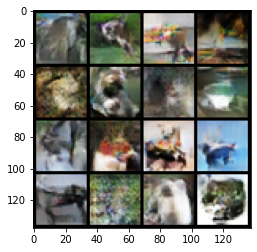

Num Iters: 24500 -- Discriminator--> Total Loss: 0.508, Real Loss: 0.532, Fake Loss: 0.484, Real Accuracy: 0.652, Fake accuracy: 0.849
Generator--> Total Loss: 1.248, Accuracy: 0.077



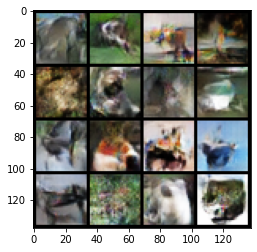

Num Iters: 25000 -- Discriminator--> Total Loss: 0.524, Real Loss: 0.548, Fake Loss: 0.499, Real Accuracy: 0.655, Fake accuracy: 0.831
Generator--> Total Loss: 1.247, Accuracy: 0.093



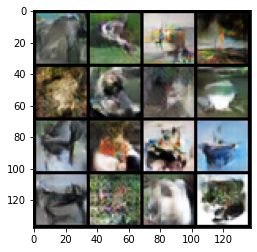

Num Iters: 25500 -- Discriminator--> Total Loss: 0.538, Real Loss: 0.556, Fake Loss: 0.521, Real Accuracy: 0.646, Fake accuracy: 0.819
Generator--> Total Loss: 1.246, Accuracy: 0.099



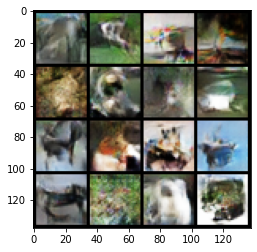

Num Iters: 26000 -- Discriminator--> Total Loss: 0.501, Real Loss: 0.526, Fake Loss: 0.476, Real Accuracy: 0.670, Fake accuracy: 0.846
Generator--> Total Loss: 1.306, Accuracy: 0.074



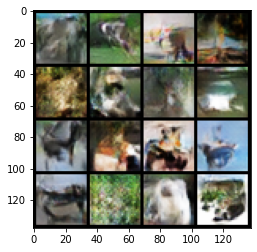

Num Iters: 26500 -- Discriminator--> Total Loss: 0.500, Real Loss: 0.524, Fake Loss: 0.477, Real Accuracy: 0.670, Fake accuracy: 0.847
Generator--> Total Loss: 1.279, Accuracy: 0.080



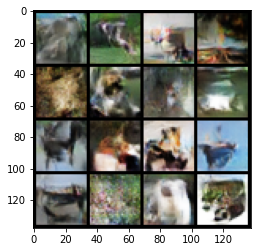

Num Iters: 27000 -- Discriminator--> Total Loss: 0.494, Real Loss: 0.516, Fake Loss: 0.471, Real Accuracy: 0.675, Fake accuracy: 0.845
Generator--> Total Loss: 1.336, Accuracy: 0.078



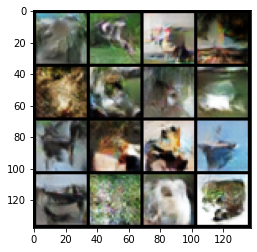

Num Iters: 27500 -- Discriminator--> Total Loss: 0.495, Real Loss: 0.517, Fake Loss: 0.473, Real Accuracy: 0.681, Fake accuracy: 0.845
Generator--> Total Loss: 1.331, Accuracy: 0.075



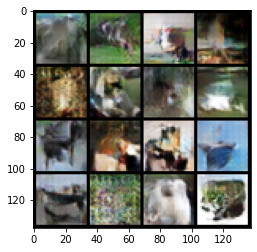

Num Iters: 28000 -- Discriminator--> Total Loss: 0.482, Real Loss: 0.509, Fake Loss: 0.455, Real Accuracy: 0.688, Fake accuracy: 0.856
Generator--> Total Loss: 1.337, Accuracy: 0.074



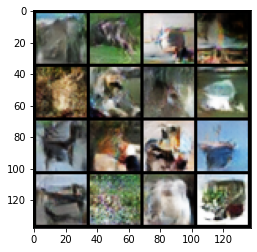

Num Iters: 28500 -- Discriminator--> Total Loss: 0.498, Real Loss: 0.517, Fake Loss: 0.479, Real Accuracy: 0.678, Fake accuracy: 0.839
Generator--> Total Loss: 1.348, Accuracy: 0.083



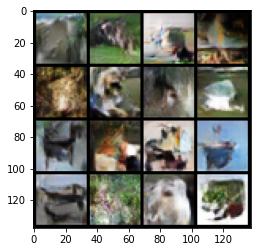

Num Iters: 29000 -- Discriminator--> Total Loss: 0.473, Real Loss: 0.498, Fake Loss: 0.447, Real Accuracy: 0.693, Fake accuracy: 0.857
Generator--> Total Loss: 1.388, Accuracy: 0.067



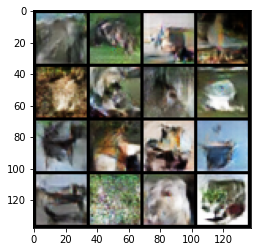

Num Iters: 29500 -- Discriminator--> Total Loss: 0.466, Real Loss: 0.494, Fake Loss: 0.439, Real Accuracy: 0.697, Fake accuracy: 0.857
Generator--> Total Loss: 1.419, Accuracy: 0.068



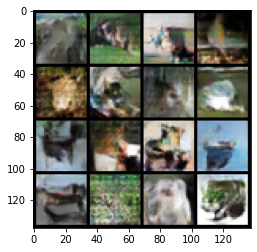

Num Iters: 30000 -- Discriminator--> Total Loss: 0.469, Real Loss: 0.495, Fake Loss: 0.443, Real Accuracy: 0.695, Fake accuracy: 0.858
Generator--> Total Loss: 1.384, Accuracy: 0.069



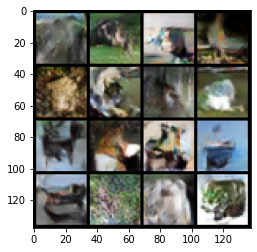

Num Iters: 30500 -- Discriminator--> Total Loss: 0.459, Real Loss: 0.484, Fake Loss: 0.434, Real Accuracy: 0.708, Fake accuracy: 0.864
Generator--> Total Loss: 1.443, Accuracy: 0.062



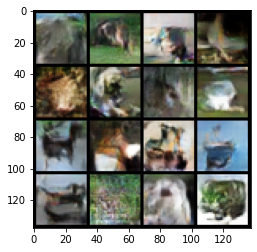

Num Iters: 31000 -- Discriminator--> Total Loss: 0.455, Real Loss: 0.481, Fake Loss: 0.430, Real Accuracy: 0.709, Fake accuracy: 0.870
Generator--> Total Loss: 1.409, Accuracy: 0.072



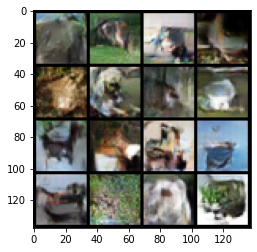

Num Iters: 31500 -- Discriminator--> Total Loss: 0.454, Real Loss: 0.480, Fake Loss: 0.428, Real Accuracy: 0.712, Fake accuracy: 0.869
Generator--> Total Loss: 1.433, Accuracy: 0.066



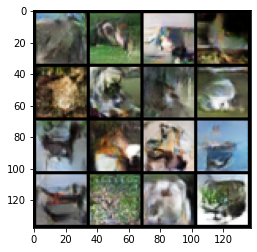

Num Iters: 32000 -- Discriminator--> Total Loss: 0.452, Real Loss: 0.476, Fake Loss: 0.429, Real Accuracy: 0.714, Fake accuracy: 0.867
Generator--> Total Loss: 1.445, Accuracy: 0.073



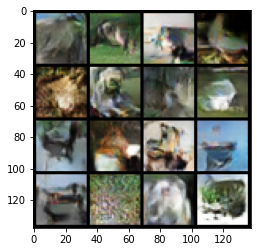

Num Iters: 32500 -- Discriminator--> Total Loss: 0.456, Real Loss: 0.483, Fake Loss: 0.428, Real Accuracy: 0.708, Fake accuracy: 0.865
Generator--> Total Loss: 1.443, Accuracy: 0.070



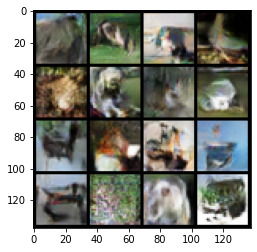

Num Iters: 33000 -- Discriminator--> Total Loss: 0.437, Real Loss: 0.465, Fake Loss: 0.410, Real Accuracy: 0.726, Fake accuracy: 0.875
Generator--> Total Loss: 1.478, Accuracy: 0.064



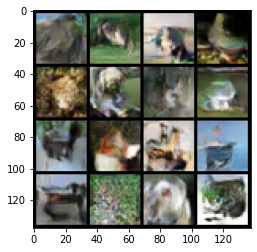

Num Iters: 33500 -- Discriminator--> Total Loss: 0.440, Real Loss: 0.466, Fake Loss: 0.415, Real Accuracy: 0.722, Fake accuracy: 0.874
Generator--> Total Loss: 1.489, Accuracy: 0.060



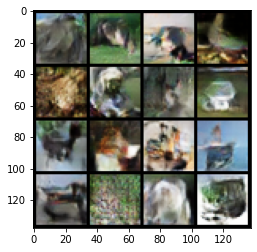

Num Iters: 34000 -- Discriminator--> Total Loss: 0.435, Real Loss: 0.461, Fake Loss: 0.409, Real Accuracy: 0.724, Fake accuracy: 0.875
Generator--> Total Loss: 1.489, Accuracy: 0.065



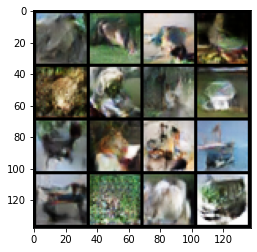

Num Iters: 34500 -- Discriminator--> Total Loss: 0.427, Real Loss: 0.453, Fake Loss: 0.400, Real Accuracy: 0.736, Fake accuracy: 0.872
Generator--> Total Loss: 1.559, Accuracy: 0.061



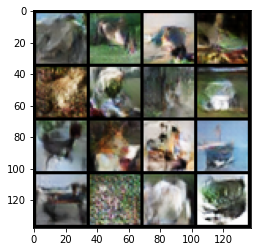

Num Iters: 35000 -- Discriminator--> Total Loss: 0.418, Real Loss: 0.444, Fake Loss: 0.391, Real Accuracy: 0.737, Fake accuracy: 0.880
Generator--> Total Loss: 1.567, Accuracy: 0.056



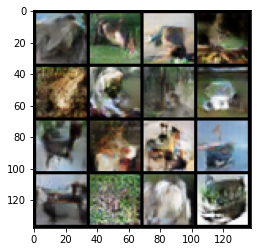

Num Iters: 35500 -- Discriminator--> Total Loss: 0.423, Real Loss: 0.449, Fake Loss: 0.397, Real Accuracy: 0.740, Fake accuracy: 0.873
Generator--> Total Loss: 1.554, Accuracy: 0.063



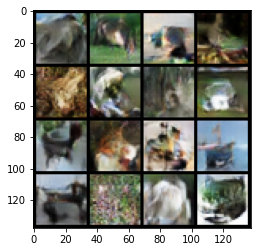

Num Iters: 36000 -- Discriminator--> Total Loss: 0.418, Real Loss: 0.445, Fake Loss: 0.391, Real Accuracy: 0.738, Fake accuracy: 0.877
Generator--> Total Loss: 1.576, Accuracy: 0.067



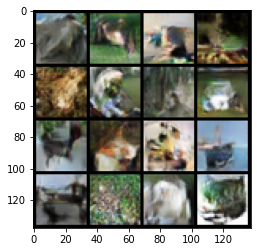

Num Iters: 36500 -- Discriminator--> Total Loss: 0.430, Real Loss: 0.453, Fake Loss: 0.407, Real Accuracy: 0.736, Fake accuracy: 0.870
Generator--> Total Loss: 1.589, Accuracy: 0.064



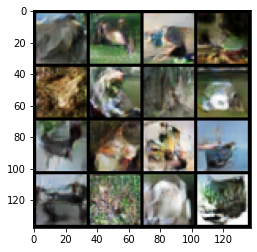

Num Iters: 37000 -- Discriminator--> Total Loss: 0.402, Real Loss: 0.428, Fake Loss: 0.376, Real Accuracy: 0.755, Fake accuracy: 0.883
Generator--> Total Loss: 1.656, Accuracy: 0.056



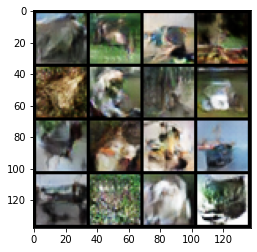

Num Iters: 37500 -- Discriminator--> Total Loss: 0.375, Real Loss: 0.400, Fake Loss: 0.351, Real Accuracy: 0.778, Fake accuracy: 0.899
Generator--> Total Loss: 1.761, Accuracy: 0.045



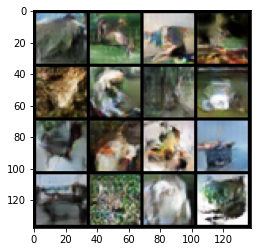

Num Iters: 38000 -- Discriminator--> Total Loss: 0.362, Real Loss: 0.382, Fake Loss: 0.342, Real Accuracy: 0.789, Fake accuracy: 0.897
Generator--> Total Loss: 1.887, Accuracy: 0.040



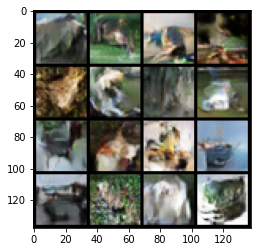

Num Iters: 38500 -- Discriminator--> Total Loss: 0.353, Real Loss: 0.374, Fake Loss: 0.332, Real Accuracy: 0.791, Fake accuracy: 0.897
Generator--> Total Loss: 1.957, Accuracy: 0.042



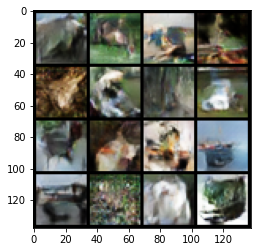

Num Iters: 39000 -- Discriminator--> Total Loss: 0.363, Real Loss: 0.386, Fake Loss: 0.341, Real Accuracy: 0.785, Fake accuracy: 0.894
Generator--> Total Loss: 1.862, Accuracy: 0.044



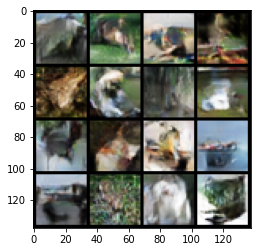

Num Iters: 39500 -- Discriminator--> Total Loss: 0.429, Real Loss: 0.437, Fake Loss: 0.422, Real Accuracy: 0.779, Fake accuracy: 0.876
Generator--> Total Loss: 1.955, Accuracy: 0.061



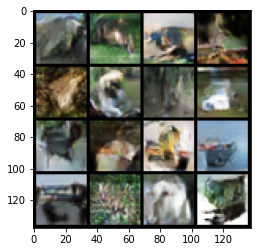

Num Iters: 40000 -- Discriminator--> Total Loss: 0.330, Real Loss: 0.345, Fake Loss: 0.315, Real Accuracy: 0.818, Fake accuracy: 0.901
Generator--> Total Loss: 2.128, Accuracy: 0.033



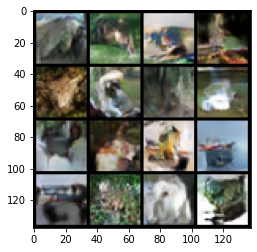

Num Iters: 40500 -- Discriminator--> Total Loss: 0.358, Real Loss: 0.379, Fake Loss: 0.336, Real Accuracy: 0.799, Fake accuracy: 0.891
Generator--> Total Loss: 1.990, Accuracy: 0.045



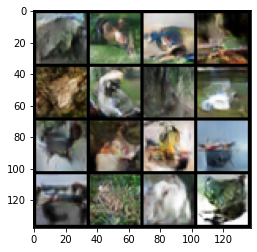

Num Iters: 41000 -- Discriminator--> Total Loss: 0.349, Real Loss: 0.372, Fake Loss: 0.325, Real Accuracy: 0.802, Fake accuracy: 0.894
Generator--> Total Loss: 2.060, Accuracy: 0.042



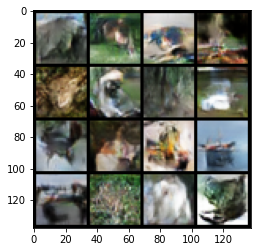

Num Iters: 41500 -- Discriminator--> Total Loss: 0.314, Real Loss: 0.330, Fake Loss: 0.298, Real Accuracy: 0.827, Fake accuracy: 0.913
Generator--> Total Loss: 2.136, Accuracy: 0.031



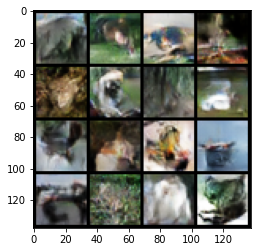

Num Iters: 42000 -- Discriminator--> Total Loss: 0.324, Real Loss: 0.341, Fake Loss: 0.307, Real Accuracy: 0.821, Fake accuracy: 0.906
Generator--> Total Loss: 2.171, Accuracy: 0.035



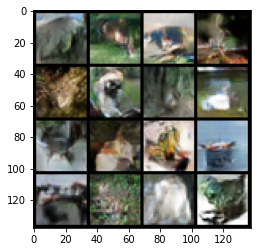

Num Iters: 42500 -- Discriminator--> Total Loss: 0.323, Real Loss: 0.341, Fake Loss: 0.305, Real Accuracy: 0.821, Fake accuracy: 0.911
Generator--> Total Loss: 2.047, Accuracy: 0.031



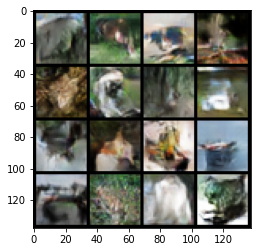

Num Iters: 43000 -- Discriminator--> Total Loss: 0.503, Real Loss: 0.416, Fake Loss: 0.589, Real Accuracy: 0.799, Fake accuracy: 0.875
Generator--> Total Loss: 2.210, Accuracy: 0.065



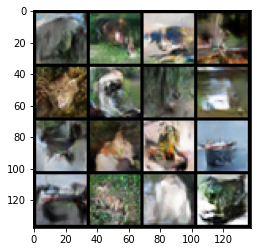

Num Iters: 43500 -- Discriminator--> Total Loss: 0.327, Real Loss: 0.347, Fake Loss: 0.308, Real Accuracy: 0.826, Fake accuracy: 0.906
Generator--> Total Loss: 2.161, Accuracy: 0.043



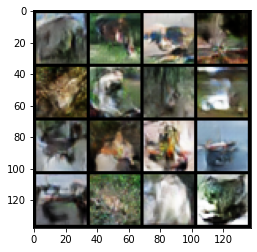

Num Iters: 44000 -- Discriminator--> Total Loss: 0.289, Real Loss: 0.306, Fake Loss: 0.272, Real Accuracy: 0.847, Fake accuracy: 0.923
Generator--> Total Loss: 2.384, Accuracy: 0.026



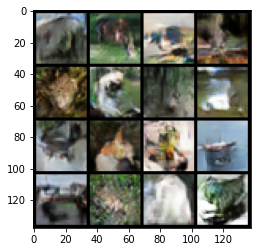

Num Iters: 44500 -- Discriminator--> Total Loss: 0.280, Real Loss: 0.296, Fake Loss: 0.263, Real Accuracy: 0.850, Fake accuracy: 0.932
Generator--> Total Loss: 2.277, Accuracy: 0.019



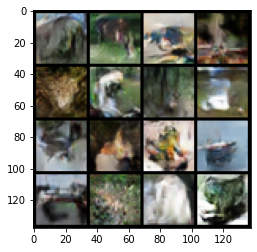

Num Iters: 45000 -- Discriminator--> Total Loss: 0.296, Real Loss: 0.311, Fake Loss: 0.281, Real Accuracy: 0.842, Fake accuracy: 0.913
Generator--> Total Loss: 2.331, Accuracy: 0.027



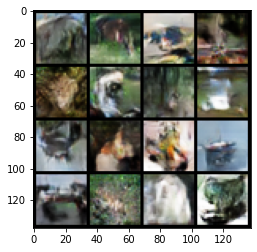

Num Iters: 45500 -- Discriminator--> Total Loss: 0.322, Real Loss: 0.342, Fake Loss: 0.303, Real Accuracy: 0.829, Fake accuracy: 0.902
Generator--> Total Loss: 2.322, Accuracy: 0.036



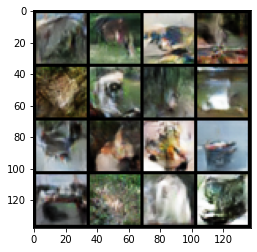

Num Iters: 46000 -- Discriminator--> Total Loss: 0.303, Real Loss: 0.320, Fake Loss: 0.286, Real Accuracy: 0.837, Fake accuracy: 0.905
Generator--> Total Loss: 2.478, Accuracy: 0.026



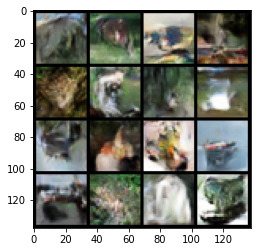

Num Iters: 46500 -- Discriminator--> Total Loss: 0.282, Real Loss: 0.299, Fake Loss: 0.264, Real Accuracy: 0.847, Fake accuracy: 0.929
Generator--> Total Loss: 2.326, Accuracy: 0.023



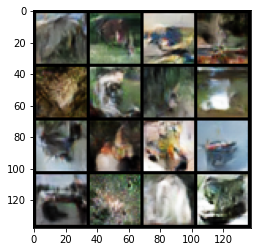

Num Iters: 47000 -- Discriminator--> Total Loss: 0.259, Real Loss: 0.273, Fake Loss: 0.245, Real Accuracy: 0.862, Fake accuracy: 0.933
Generator--> Total Loss: 2.510, Accuracy: 0.017



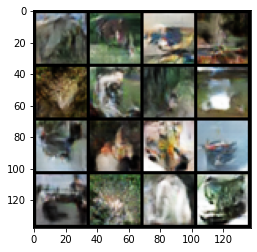

Num Iters: 47500 -- Discriminator--> Total Loss: 0.260, Real Loss: 0.276, Fake Loss: 0.245, Real Accuracy: 0.864, Fake accuracy: 0.933
Generator--> Total Loss: 2.447, Accuracy: 0.020



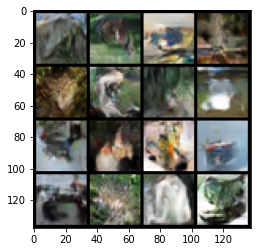

Num Iters: 48000 -- Discriminator--> Total Loss: 0.271, Real Loss: 0.287, Fake Loss: 0.255, Real Accuracy: 0.854, Fake accuracy: 0.924
Generator--> Total Loss: 2.453, Accuracy: 0.023



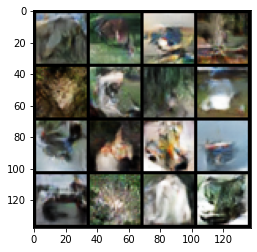

Num Iters: 48500 -- Discriminator--> Total Loss: 0.274, Real Loss: 0.291, Fake Loss: 0.257, Real Accuracy: 0.857, Fake accuracy: 0.923
Generator--> Total Loss: 2.448, Accuracy: 0.025



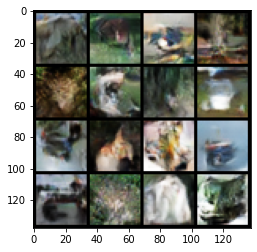

Num Iters: 49000 -- Discriminator--> Total Loss: 0.271, Real Loss: 0.284, Fake Loss: 0.257, Real Accuracy: 0.861, Fake accuracy: 0.924
Generator--> Total Loss: 2.495, Accuracy: 0.020



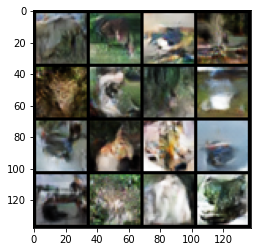

Num Iters: 49500 -- Discriminator--> Total Loss: 0.289, Real Loss: 0.304, Fake Loss: 0.274, Real Accuracy: 0.849, Fake accuracy: 0.914
Generator--> Total Loss: 2.479, Accuracy: 0.031



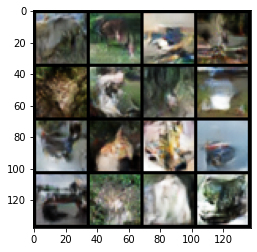

Num Iters: 50000 -- Discriminator--> Total Loss: 0.283, Real Loss: 0.297, Fake Loss: 0.269, Real Accuracy: 0.852, Fake accuracy: 0.918
Generator--> Total Loss: 2.408, Accuracy: 0.025



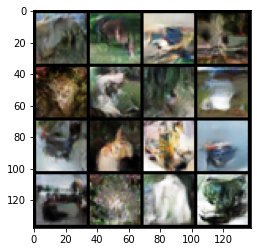

Num Iters: 50500 -- Discriminator--> Total Loss: 0.259, Real Loss: 0.277, Fake Loss: 0.242, Real Accuracy: 0.869, Fake accuracy: 0.931
Generator--> Total Loss: 2.494, Accuracy: 0.022



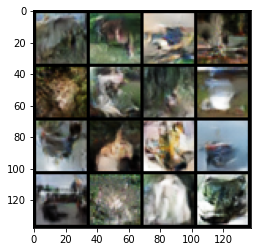

Num Iters: 51000 -- Discriminator--> Total Loss: 0.260, Real Loss: 0.276, Fake Loss: 0.244, Real Accuracy: 0.864, Fake accuracy: 0.931
Generator--> Total Loss: 2.439, Accuracy: 0.023



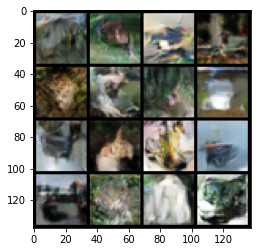

Num Iters: 51500 -- Discriminator--> Total Loss: 0.294, Real Loss: 0.313, Fake Loss: 0.274, Real Accuracy: 0.853, Fake accuracy: 0.913
Generator--> Total Loss: 2.652, Accuracy: 0.034



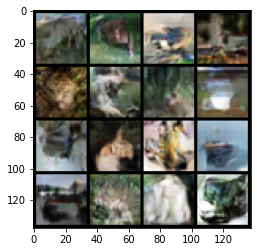

Num Iters: 52000 -- Discriminator--> Total Loss: 0.261, Real Loss: 0.282, Fake Loss: 0.241, Real Accuracy: 0.866, Fake accuracy: 0.929
Generator--> Total Loss: 2.663, Accuracy: 0.024



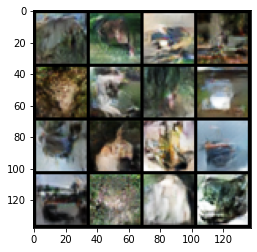

Num Iters: 52500 -- Discriminator--> Total Loss: 0.270, Real Loss: 0.283, Fake Loss: 0.257, Real Accuracy: 0.870, Fake accuracy: 0.926
Generator--> Total Loss: 2.709, Accuracy: 0.032



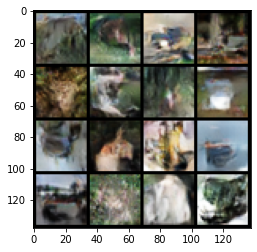

Num Iters: 53000 -- Discriminator--> Total Loss: 0.249, Real Loss: 0.263, Fake Loss: 0.235, Real Accuracy: 0.875, Fake accuracy: 0.928
Generator--> Total Loss: 2.735, Accuracy: 0.023



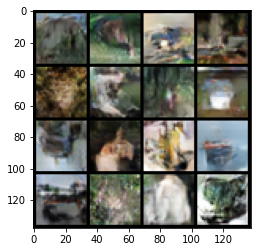

Num Iters: 53500 -- Discriminator--> Total Loss: 0.339, Real Loss: 0.349, Fake Loss: 0.328, Real Accuracy: 0.840, Fake accuracy: 0.901
Generator--> Total Loss: 2.519, Accuracy: 0.040



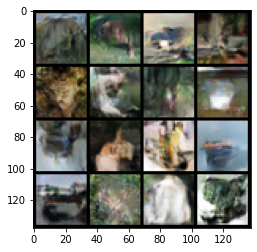

Num Iters: 54000 -- Discriminator--> Total Loss: 0.247, Real Loss: 0.259, Fake Loss: 0.235, Real Accuracy: 0.878, Fake accuracy: 0.930
Generator--> Total Loss: 2.785, Accuracy: 0.018



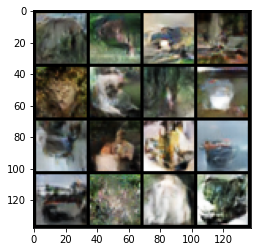

Num Iters: 54500 -- Discriminator--> Total Loss: 0.247, Real Loss: 0.260, Fake Loss: 0.234, Real Accuracy: 0.872, Fake accuracy: 0.928
Generator--> Total Loss: 2.645, Accuracy: 0.020



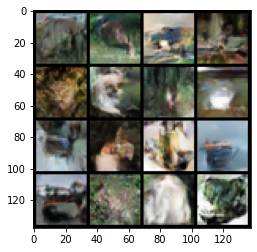

Num Iters: 55000 -- Discriminator--> Total Loss: 0.234, Real Loss: 0.245, Fake Loss: 0.223, Real Accuracy: 0.882, Fake accuracy: 0.930
Generator--> Total Loss: 2.816, Accuracy: 0.018



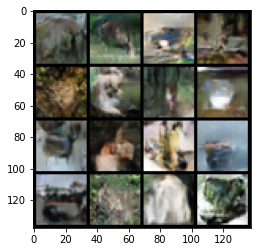

Num Iters: 55500 -- Discriminator--> Total Loss: 0.240, Real Loss: 0.255, Fake Loss: 0.226, Real Accuracy: 0.877, Fake accuracy: 0.933
Generator--> Total Loss: 2.718, Accuracy: 0.021



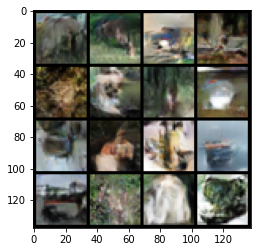

Num Iters: 56000 -- Discriminator--> Total Loss: 0.296, Real Loss: 0.314, Fake Loss: 0.278, Real Accuracy: 0.858, Fake accuracy: 0.914
Generator--> Total Loss: 2.632, Accuracy: 0.035



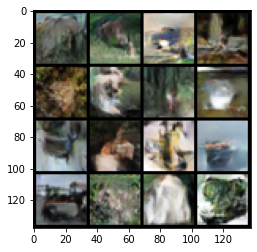

Num Iters: 56500 -- Discriminator--> Total Loss: 0.205, Real Loss: 0.217, Fake Loss: 0.192, Real Accuracy: 0.900, Fake accuracy: 0.947
Generator--> Total Loss: 2.991, Accuracy: 0.011



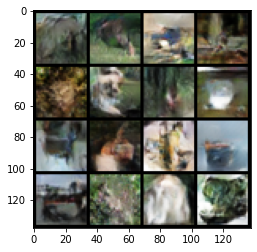

Num Iters: 57000 -- Discriminator--> Total Loss: 0.335, Real Loss: 0.328, Fake Loss: 0.341, Real Accuracy: 0.851, Fake accuracy: 0.911
Generator--> Total Loss: 2.664, Accuracy: 0.040



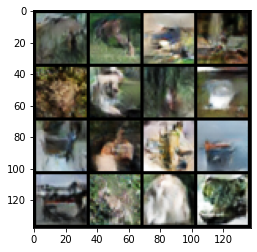

Num Iters: 57500 -- Discriminator--> Total Loss: 0.227, Real Loss: 0.241, Fake Loss: 0.213, Real Accuracy: 0.883, Fake accuracy: 0.934
Generator--> Total Loss: 2.921, Accuracy: 0.025



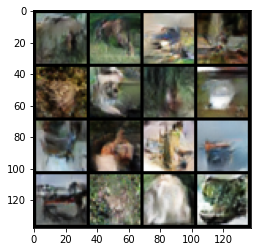

Num Iters: 58000 -- Discriminator--> Total Loss: 0.233, Real Loss: 0.244, Fake Loss: 0.222, Real Accuracy: 0.885, Fake accuracy: 0.931
Generator--> Total Loss: 2.889, Accuracy: 0.018



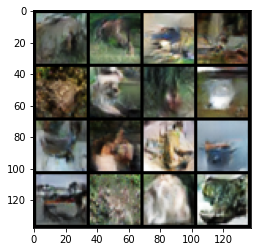

Num Iters: 58500 -- Discriminator--> Total Loss: 0.242, Real Loss: 0.251, Fake Loss: 0.232, Real Accuracy: 0.883, Fake accuracy: 0.936
Generator--> Total Loss: 2.849, Accuracy: 0.022



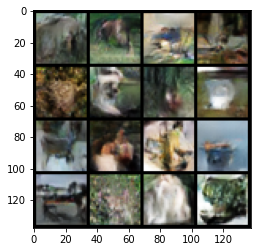

Num Iters: 59000 -- Discriminator--> Total Loss: 0.237, Real Loss: 0.247, Fake Loss: 0.227, Real Accuracy: 0.881, Fake accuracy: 0.930
Generator--> Total Loss: 2.781, Accuracy: 0.020



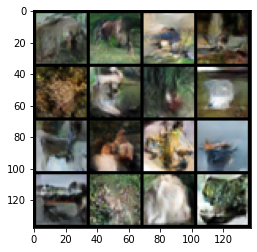

Num Iters: 59500 -- Discriminator--> Total Loss: 0.297, Real Loss: 0.305, Fake Loss: 0.290, Real Accuracy: 0.861, Fake accuracy: 0.916
Generator--> Total Loss: 2.781, Accuracy: 0.031



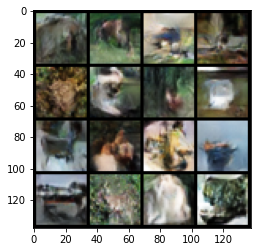

Num Iters: 60000 -- Discriminator--> Total Loss: 0.241, Real Loss: 0.250, Fake Loss: 0.232, Real Accuracy: 0.884, Fake accuracy: 0.930
Generator--> Total Loss: 2.782, Accuracy: 0.025



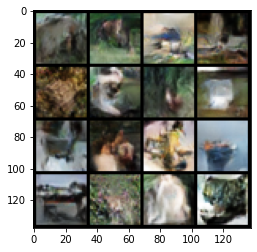

Num Iters: 60500 -- Discriminator--> Total Loss: 0.216, Real Loss: 0.223, Fake Loss: 0.208, Real Accuracy: 0.895, Fake accuracy: 0.939
Generator--> Total Loss: 2.853, Accuracy: 0.013



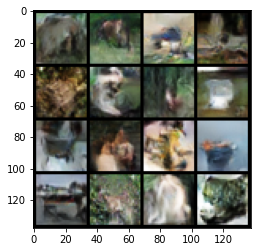

Num Iters: 61000 -- Discriminator--> Total Loss: 0.228, Real Loss: 0.237, Fake Loss: 0.218, Real Accuracy: 0.889, Fake accuracy: 0.934
Generator--> Total Loss: 2.882, Accuracy: 0.018



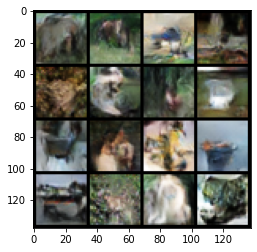

Num Iters: 61500 -- Discriminator--> Total Loss: 0.222, Real Loss: 0.230, Fake Loss: 0.214, Real Accuracy: 0.893, Fake accuracy: 0.935
Generator--> Total Loss: 2.876, Accuracy: 0.016



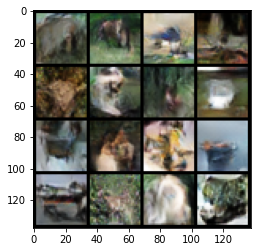

Num Iters: 62000 -- Discriminator--> Total Loss: 0.320, Real Loss: 0.311, Fake Loss: 0.328, Real Accuracy: 0.862, Fake accuracy: 0.906
Generator--> Total Loss: 2.839, Accuracy: 0.044



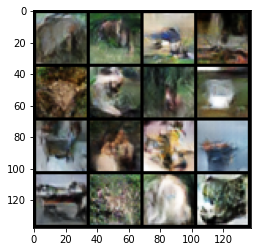

Num Iters: 62500 -- Discriminator--> Total Loss: 0.230, Real Loss: 0.240, Fake Loss: 0.220, Real Accuracy: 0.885, Fake accuracy: 0.929
Generator--> Total Loss: 3.059, Accuracy: 0.025



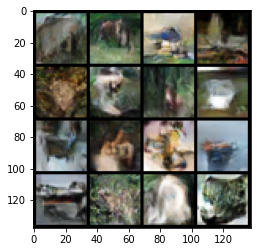

Num Iters: 63000 -- Discriminator--> Total Loss: 0.211, Real Loss: 0.222, Fake Loss: 0.200, Real Accuracy: 0.892, Fake accuracy: 0.938
Generator--> Total Loss: 3.046, Accuracy: 0.014



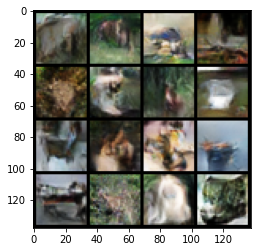

Num Iters: 63500 -- Discriminator--> Total Loss: 0.211, Real Loss: 0.223, Fake Loss: 0.198, Real Accuracy: 0.897, Fake accuracy: 0.942
Generator--> Total Loss: 2.941, Accuracy: 0.013



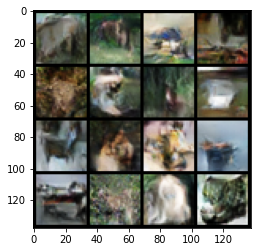

Num Iters: 64000 -- Discriminator--> Total Loss: 0.207, Real Loss: 0.219, Fake Loss: 0.196, Real Accuracy: 0.900, Fake accuracy: 0.943
Generator--> Total Loss: 3.068, Accuracy: 0.021



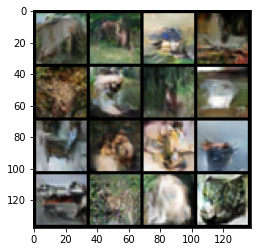

Num Iters: 64500 -- Discriminator--> Total Loss: 0.342, Real Loss: 0.326, Fake Loss: 0.358, Real Accuracy: 0.867, Fake accuracy: 0.913
Generator--> Total Loss: 2.863, Accuracy: 0.043



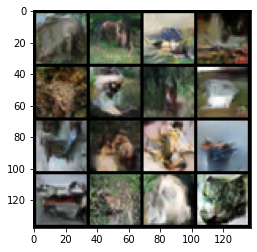

Num Iters: 65000 -- Discriminator--> Total Loss: 0.308, Real Loss: 0.322, Fake Loss: 0.294, Real Accuracy: 0.867, Fake accuracy: 0.907
Generator--> Total Loss: 2.808, Accuracy: 0.038



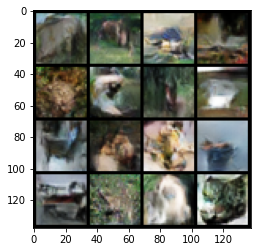

Num Iters: 65500 -- Discriminator--> Total Loss: 0.201, Real Loss: 0.213, Fake Loss: 0.189, Real Accuracy: 0.903, Fake accuracy: 0.944
Generator--> Total Loss: 3.069, Accuracy: 0.015



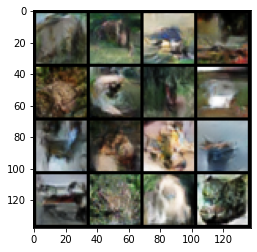

Num Iters: 66000 -- Discriminator--> Total Loss: 0.202, Real Loss: 0.211, Fake Loss: 0.194, Real Accuracy: 0.903, Fake accuracy: 0.942
Generator--> Total Loss: 3.080, Accuracy: 0.014



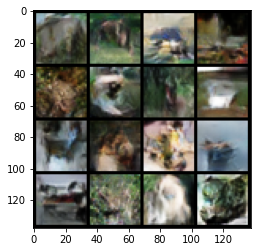

Num Iters: 66500 -- Discriminator--> Total Loss: 0.184, Real Loss: 0.193, Fake Loss: 0.175, Real Accuracy: 0.911, Fake accuracy: 0.950
Generator--> Total Loss: 3.186, Accuracy: 0.011



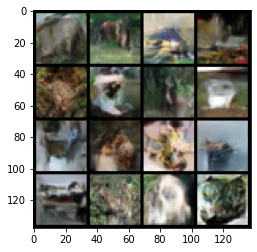

Num Iters: 67000 -- Discriminator--> Total Loss: 0.239, Real Loss: 0.251, Fake Loss: 0.227, Real Accuracy: 0.889, Fake accuracy: 0.927
Generator--> Total Loss: 3.154, Accuracy: 0.024



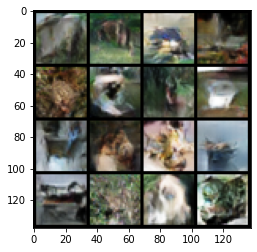

Num Iters: 67500 -- Discriminator--> Total Loss: 0.231, Real Loss: 0.246, Fake Loss: 0.216, Real Accuracy: 0.883, Fake accuracy: 0.930
Generator--> Total Loss: 3.040, Accuracy: 0.026



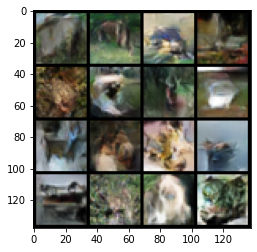

Num Iters: 68000 -- Discriminator--> Total Loss: 0.360, Real Loss: 0.340, Fake Loss: 0.379, Real Accuracy: 0.861, Fake accuracy: 0.902
Generator--> Total Loss: 2.990, Accuracy: 0.051



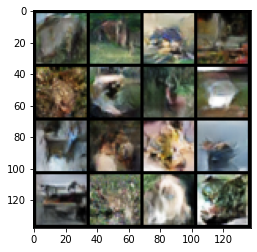

Num Iters: 68500 -- Discriminator--> Total Loss: 0.207, Real Loss: 0.216, Fake Loss: 0.199, Real Accuracy: 0.898, Fake accuracy: 0.939
Generator--> Total Loss: 2.928, Accuracy: 0.017



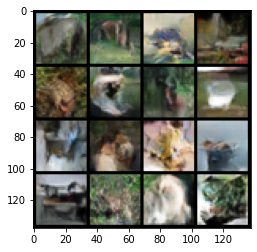

Num Iters: 69000 -- Discriminator--> Total Loss: 0.189, Real Loss: 0.197, Fake Loss: 0.182, Real Accuracy: 0.910, Fake accuracy: 0.943
Generator--> Total Loss: 3.240, Accuracy: 0.015



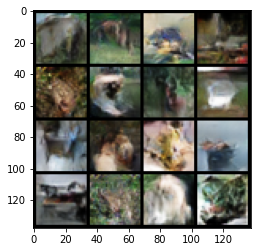

Num Iters: 69500 -- Discriminator--> Total Loss: 0.197, Real Loss: 0.203, Fake Loss: 0.190, Real Accuracy: 0.906, Fake accuracy: 0.940
Generator--> Total Loss: 3.170, Accuracy: 0.020



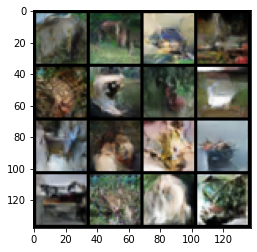

Num Iters: 70000 -- Discriminator--> Total Loss: 0.177, Real Loss: 0.186, Fake Loss: 0.168, Real Accuracy: 0.917, Fake accuracy: 0.952
Generator--> Total Loss: 3.305, Accuracy: 0.013



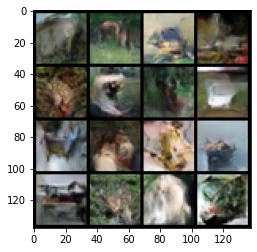

Num Iters: 70500 -- Discriminator--> Total Loss: 0.185, Real Loss: 0.192, Fake Loss: 0.177, Real Accuracy: 0.913, Fake accuracy: 0.947
Generator--> Total Loss: 3.312, Accuracy: 0.014



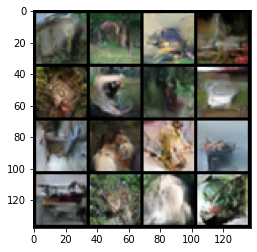

Num Iters: 71000 -- Discriminator--> Total Loss: 0.180, Real Loss: 0.187, Fake Loss: 0.172, Real Accuracy: 0.914, Fake accuracy: 0.950
Generator--> Total Loss: 3.252, Accuracy: 0.012



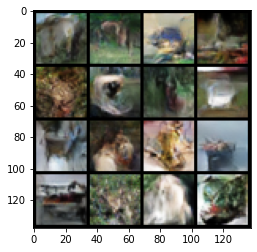

Num Iters: 71500 -- Discriminator--> Total Loss: 0.217, Real Loss: 0.229, Fake Loss: 0.206, Real Accuracy: 0.900, Fake accuracy: 0.934
Generator--> Total Loss: 3.257, Accuracy: 0.022



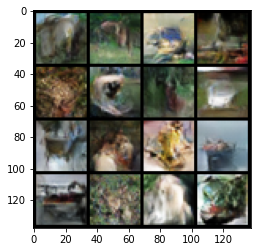

Num Iters: 72000 -- Discriminator--> Total Loss: 0.181, Real Loss: 0.188, Fake Loss: 0.174, Real Accuracy: 0.917, Fake accuracy: 0.948
Generator--> Total Loss: 3.317, Accuracy: 0.011



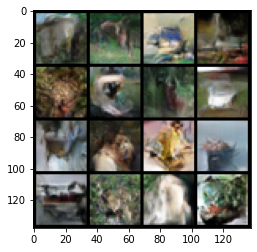

Num Iters: 72500 -- Discriminator--> Total Loss: 0.195, Real Loss: 0.207, Fake Loss: 0.182, Real Accuracy: 0.912, Fake accuracy: 0.946
Generator--> Total Loss: 3.373, Accuracy: 0.015



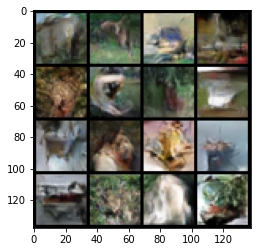

Num Iters: 73000 -- Discriminator--> Total Loss: 0.239, Real Loss: 0.248, Fake Loss: 0.229, Real Accuracy: 0.879, Fake accuracy: 0.924
Generator--> Total Loss: 2.885, Accuracy: 0.027



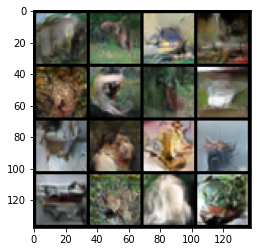

Num Iters: 73500 -- Discriminator--> Total Loss: 0.154, Real Loss: 0.161, Fake Loss: 0.147, Real Accuracy: 0.930, Fake accuracy: 0.959
Generator--> Total Loss: 3.443, Accuracy: 0.009



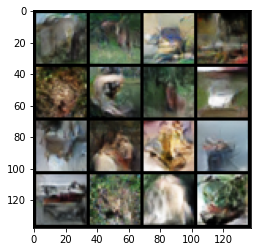

Num Iters: 74000 -- Discriminator--> Total Loss: 0.161, Real Loss: 0.165, Fake Loss: 0.157, Real Accuracy: 0.929, Fake accuracy: 0.954
Generator--> Total Loss: 3.546, Accuracy: 0.007



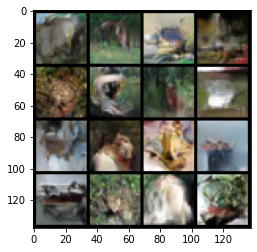

Num Iters: 74500 -- Discriminator--> Total Loss: 0.161, Real Loss: 0.168, Fake Loss: 0.154, Real Accuracy: 0.925, Fake accuracy: 0.956
Generator--> Total Loss: 3.379, Accuracy: 0.008



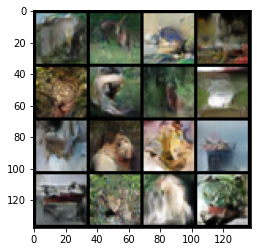

Num Iters: 75000 -- Discriminator--> Total Loss: 0.240, Real Loss: 0.238, Fake Loss: 0.242, Real Accuracy: 0.896, Fake accuracy: 0.930
Generator--> Total Loss: 3.193, Accuracy: 0.025



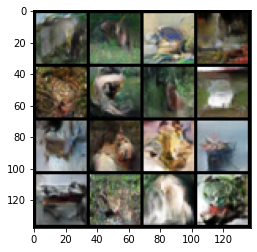

Num Iters: 75500 -- Discriminator--> Total Loss: 0.230, Real Loss: 0.241, Fake Loss: 0.220, Real Accuracy: 0.901, Fake accuracy: 0.929
Generator--> Total Loss: 3.563, Accuracy: 0.026



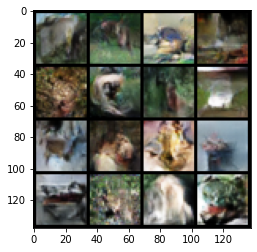

Num Iters: 76000 -- Discriminator--> Total Loss: 0.211, Real Loss: 0.216, Fake Loss: 0.206, Real Accuracy: 0.909, Fake accuracy: 0.937
Generator--> Total Loss: 3.339, Accuracy: 0.020



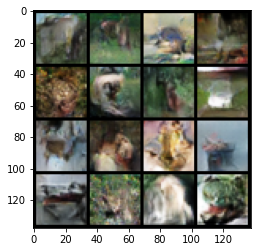

Num Iters: 76500 -- Discriminator--> Total Loss: 0.159, Real Loss: 0.163, Fake Loss: 0.154, Real Accuracy: 0.929, Fake accuracy: 0.953
Generator--> Total Loss: 3.549, Accuracy: 0.008



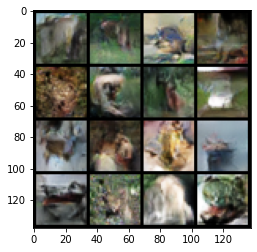

Num Iters: 77000 -- Discriminator--> Total Loss: 0.154, Real Loss: 0.159, Fake Loss: 0.150, Real Accuracy: 0.929, Fake accuracy: 0.956
Generator--> Total Loss: 3.606, Accuracy: 0.011



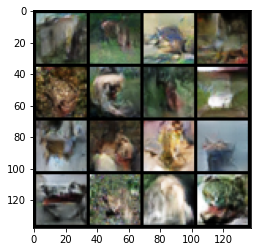

Num Iters: 77500 -- Discriminator--> Total Loss: 0.172, Real Loss: 0.178, Fake Loss: 0.167, Real Accuracy: 0.922, Fake accuracy: 0.952
Generator--> Total Loss: 3.601, Accuracy: 0.013



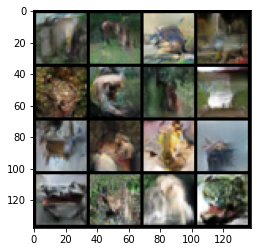

Num Iters: 78000 -- Discriminator--> Total Loss: 0.155, Real Loss: 0.159, Fake Loss: 0.151, Real Accuracy: 0.930, Fake accuracy: 0.956
Generator--> Total Loss: 3.630, Accuracy: 0.007



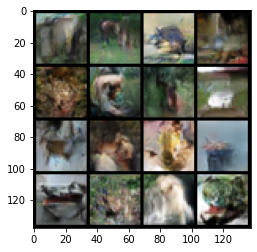

Num Iters: 78500 -- Discriminator--> Total Loss: 0.153, Real Loss: 0.158, Fake Loss: 0.147, Real Accuracy: 0.930, Fake accuracy: 0.957
Generator--> Total Loss: 3.655, Accuracy: 0.006



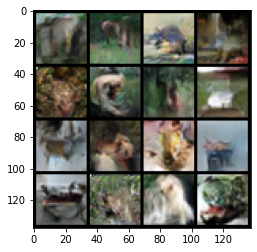

Num Iters: 79000 -- Discriminator--> Total Loss: 0.153, Real Loss: 0.157, Fake Loss: 0.150, Real Accuracy: 0.932, Fake accuracy: 0.959
Generator--> Total Loss: 3.536, Accuracy: 0.008



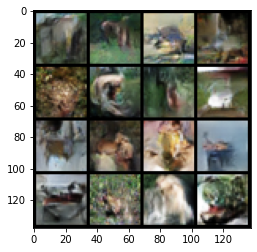

Num Iters: 79500 -- Discriminator--> Total Loss: 0.154, Real Loss: 0.159, Fake Loss: 0.149, Real Accuracy: 0.933, Fake accuracy: 0.954
Generator--> Total Loss: 3.560, Accuracy: 0.007



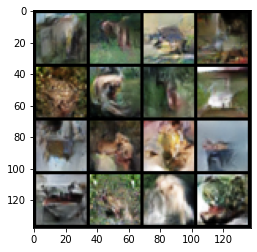

Num Iters: 80000 -- Discriminator--> Total Loss: 0.156, Real Loss: 0.165, Fake Loss: 0.147, Real Accuracy: 0.932, Fake accuracy: 0.956
Generator--> Total Loss: 3.713, Accuracy: 0.009



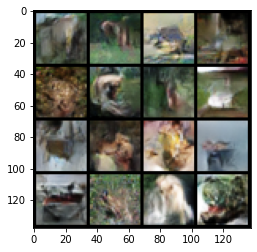

Num Iters: 80500 -- Discriminator--> Total Loss: 0.162, Real Loss: 0.167, Fake Loss: 0.157, Real Accuracy: 0.924, Fake accuracy: 0.949
Generator--> Total Loss: 3.725, Accuracy: 0.010



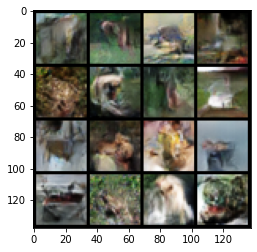

Num Iters: 81000 -- Discriminator--> Total Loss: 0.165, Real Loss: 0.169, Fake Loss: 0.160, Real Accuracy: 0.923, Fake accuracy: 0.950
Generator--> Total Loss: 3.550, Accuracy: 0.010



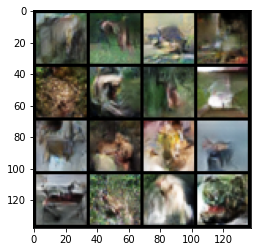

Num Iters: 81500 -- Discriminator--> Total Loss: 0.155, Real Loss: 0.160, Fake Loss: 0.151, Real Accuracy: 0.931, Fake accuracy: 0.954
Generator--> Total Loss: 3.664, Accuracy: 0.009



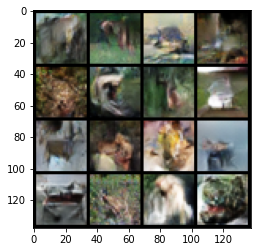

Num Iters: 82000 -- Discriminator--> Total Loss: 0.147, Real Loss: 0.147, Fake Loss: 0.147, Real Accuracy: 0.937, Fake accuracy: 0.957
Generator--> Total Loss: 3.605, Accuracy: 0.009



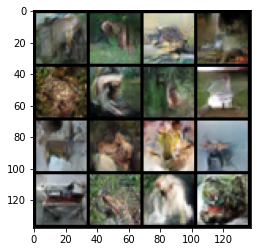

Num Iters: 82500 -- Discriminator--> Total Loss: 0.179, Real Loss: 0.186, Fake Loss: 0.172, Real Accuracy: 0.922, Fake accuracy: 0.946
Generator--> Total Loss: 3.793, Accuracy: 0.016



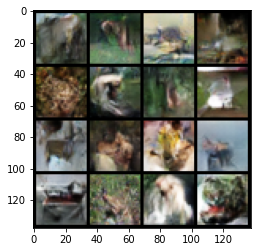

Num Iters: 83000 -- Discriminator--> Total Loss: 0.175, Real Loss: 0.175, Fake Loss: 0.176, Real Accuracy: 0.926, Fake accuracy: 0.950
Generator--> Total Loss: 3.674, Accuracy: 0.014



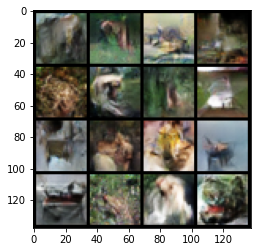

Num Iters: 83500 -- Discriminator--> Total Loss: 0.187, Real Loss: 0.195, Fake Loss: 0.179, Real Accuracy: 0.920, Fake accuracy: 0.938
Generator--> Total Loss: 3.864, Accuracy: 0.022



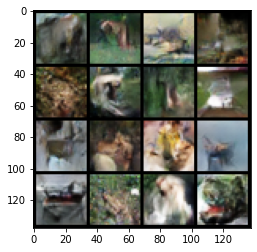

Num Iters: 84000 -- Discriminator--> Total Loss: 0.134, Real Loss: 0.136, Fake Loss: 0.133, Real Accuracy: 0.945, Fake accuracy: 0.961
Generator--> Total Loss: 3.752, Accuracy: 0.008



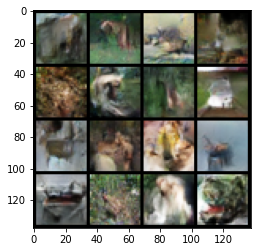

Num Iters: 84500 -- Discriminator--> Total Loss: 0.194, Real Loss: 0.198, Fake Loss: 0.189, Real Accuracy: 0.918, Fake accuracy: 0.940
Generator--> Total Loss: 3.673, Accuracy: 0.017



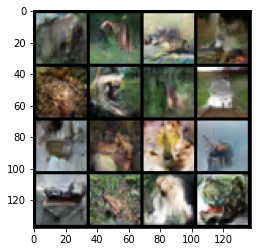

Num Iters: 85000 -- Discriminator--> Total Loss: 0.137, Real Loss: 0.138, Fake Loss: 0.137, Real Accuracy: 0.941, Fake accuracy: 0.957
Generator--> Total Loss: 3.901, Accuracy: 0.007



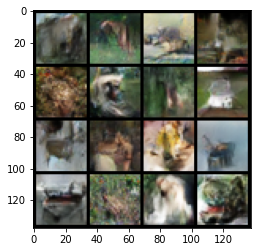

Num Iters: 85500 -- Discriminator--> Total Loss: 0.130, Real Loss: 0.130, Fake Loss: 0.130, Real Accuracy: 0.946, Fake accuracy: 0.961
Generator--> Total Loss: 3.971, Accuracy: 0.008



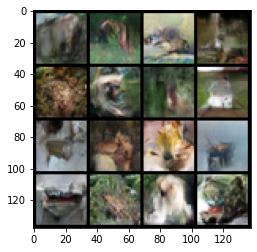

Num Iters: 86000 -- Discriminator--> Total Loss: 0.138, Real Loss: 0.141, Fake Loss: 0.134, Real Accuracy: 0.939, Fake accuracy: 0.961
Generator--> Total Loss: 3.840, Accuracy: 0.007



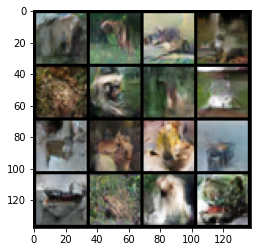

Num Iters: 86500 -- Discriminator--> Total Loss: 0.130, Real Loss: 0.130, Fake Loss: 0.130, Real Accuracy: 0.947, Fake accuracy: 0.962
Generator--> Total Loss: 3.952, Accuracy: 0.005



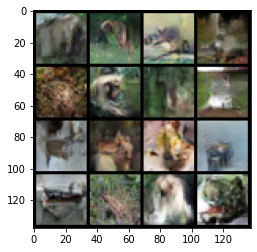

Num Iters: 87000 -- Discriminator--> Total Loss: 0.123, Real Loss: 0.125, Fake Loss: 0.121, Real Accuracy: 0.949, Fake accuracy: 0.965
Generator--> Total Loss: 3.962, Accuracy: 0.006



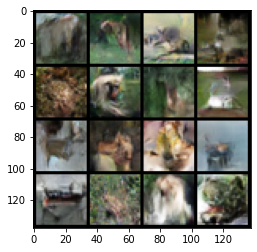

Num Iters: 87500 -- Discriminator--> Total Loss: 0.148, Real Loss: 0.148, Fake Loss: 0.147, Real Accuracy: 0.938, Fake accuracy: 0.954
Generator--> Total Loss: 3.803, Accuracy: 0.013



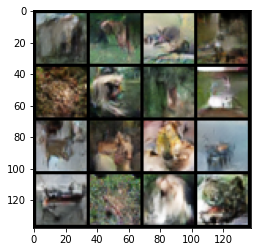

Num Iters: 88000 -- Discriminator--> Total Loss: 0.129, Real Loss: 0.131, Fake Loss: 0.127, Real Accuracy: 0.946, Fake accuracy: 0.964
Generator--> Total Loss: 3.909, Accuracy: 0.006



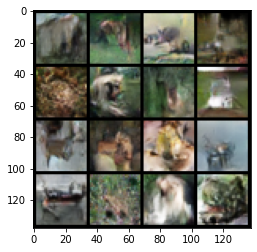

Num Iters: 88500 -- Discriminator--> Total Loss: 0.132, Real Loss: 0.132, Fake Loss: 0.132, Real Accuracy: 0.946, Fake accuracy: 0.960
Generator--> Total Loss: 3.846, Accuracy: 0.005



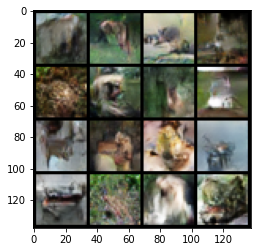

Num Iters: 89000 -- Discriminator--> Total Loss: 0.129, Real Loss: 0.127, Fake Loss: 0.131, Real Accuracy: 0.951, Fake accuracy: 0.963
Generator--> Total Loss: 3.882, Accuracy: 0.008



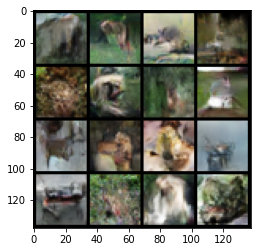

Num Iters: 89500 -- Discriminator--> Total Loss: 0.130, Real Loss: 0.130, Fake Loss: 0.131, Real Accuracy: 0.947, Fake accuracy: 0.962
Generator--> Total Loss: 3.924, Accuracy: 0.007



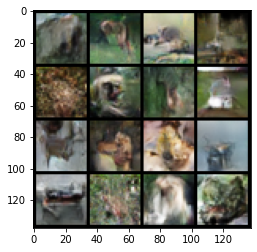

Num Iters: 90000 -- Discriminator--> Total Loss: 0.140, Real Loss: 0.139, Fake Loss: 0.141, Real Accuracy: 0.941, Fake accuracy: 0.955
Generator--> Total Loss: 3.880, Accuracy: 0.008



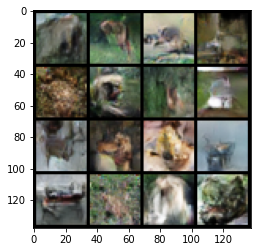

Num Iters: 90500 -- Discriminator--> Total Loss: 0.127, Real Loss: 0.130, Fake Loss: 0.124, Real Accuracy: 0.945, Fake accuracy: 0.963
Generator--> Total Loss: 4.031, Accuracy: 0.007



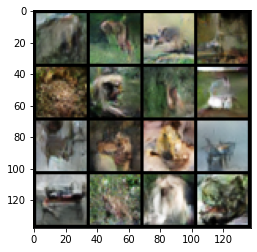

Num Iters: 91000 -- Discriminator--> Total Loss: 0.166, Real Loss: 0.168, Fake Loss: 0.165, Real Accuracy: 0.927, Fake accuracy: 0.949
Generator--> Total Loss: 3.832, Accuracy: 0.015



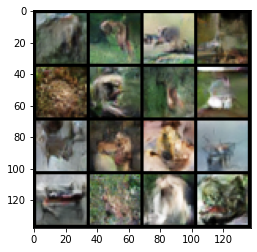

Num Iters: 91500 -- Discriminator--> Total Loss: 0.154, Real Loss: 0.155, Fake Loss: 0.153, Real Accuracy: 0.933, Fake accuracy: 0.951
Generator--> Total Loss: 3.981, Accuracy: 0.012



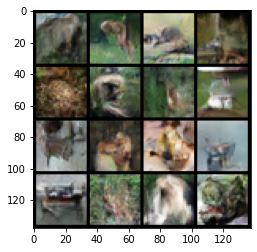

Num Iters: 92000 -- Discriminator--> Total Loss: 0.221, Real Loss: 0.207, Fake Loss: 0.234, Real Accuracy: 0.919, Fake accuracy: 0.937
Generator--> Total Loss: 3.873, Accuracy: 0.021



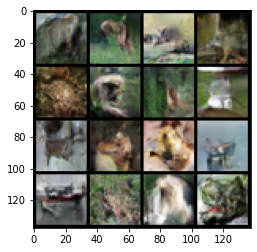

Num Iters: 92500 -- Discriminator--> Total Loss: 0.137, Real Loss: 0.137, Fake Loss: 0.136, Real Accuracy: 0.944, Fake accuracy: 0.959
Generator--> Total Loss: 3.965, Accuracy: 0.006



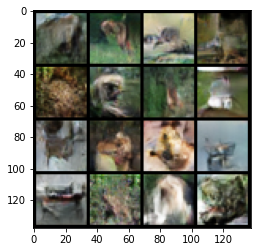

Num Iters: 93000 -- Discriminator--> Total Loss: 0.154, Real Loss: 0.152, Fake Loss: 0.156, Real Accuracy: 0.937, Fake accuracy: 0.952
Generator--> Total Loss: 3.882, Accuracy: 0.011



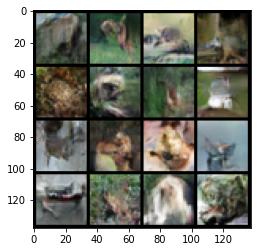

Num Iters: 93500 -- Discriminator--> Total Loss: 0.128, Real Loss: 0.127, Fake Loss: 0.129, Real Accuracy: 0.948, Fake accuracy: 0.959
Generator--> Total Loss: 4.208, Accuracy: 0.007



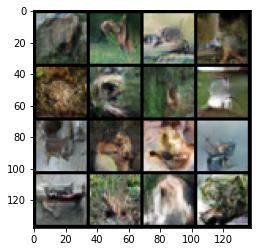

Num Iters: 94000 -- Discriminator--> Total Loss: 0.133, Real Loss: 0.135, Fake Loss: 0.131, Real Accuracy: 0.947, Fake accuracy: 0.958
Generator--> Total Loss: 4.169, Accuracy: 0.009



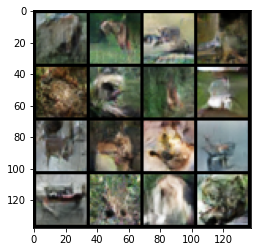

Num Iters: 94500 -- Discriminator--> Total Loss: 0.133, Real Loss: 0.138, Fake Loss: 0.128, Real Accuracy: 0.944, Fake accuracy: 0.961
Generator--> Total Loss: 4.029, Accuracy: 0.006



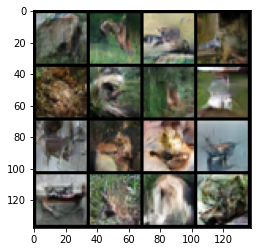

Num Iters: 95000 -- Discriminator--> Total Loss: 0.113, Real Loss: 0.112, Fake Loss: 0.113, Real Accuracy: 0.953, Fake accuracy: 0.966
Generator--> Total Loss: 4.161, Accuracy: 0.003



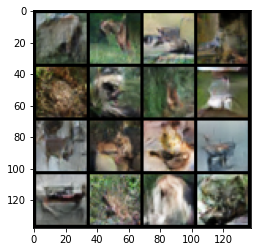

Num Iters: 95500 -- Discriminator--> Total Loss: 0.129, Real Loss: 0.128, Fake Loss: 0.130, Real Accuracy: 0.947, Fake accuracy: 0.964
Generator--> Total Loss: 3.727, Accuracy: 0.008



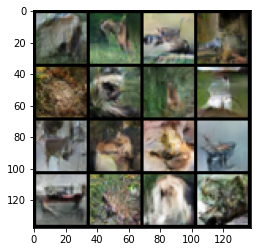

Num Iters: 96000 -- Discriminator--> Total Loss: 0.109, Real Loss: 0.108, Fake Loss: 0.109, Real Accuracy: 0.957, Fake accuracy: 0.968
Generator--> Total Loss: 4.226, Accuracy: 0.004



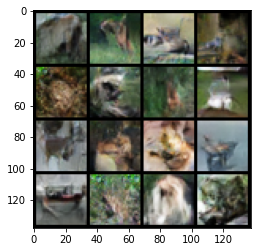

Num Iters: 96500 -- Discriminator--> Total Loss: 0.189, Real Loss: 0.190, Fake Loss: 0.188, Real Accuracy: 0.925, Fake accuracy: 0.937
Generator--> Total Loss: 4.014, Accuracy: 0.018



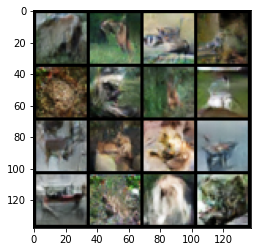

Num Iters: 97000 -- Discriminator--> Total Loss: 0.120, Real Loss: 0.120, Fake Loss: 0.120, Real Accuracy: 0.951, Fake accuracy: 0.962
Generator--> Total Loss: 4.194, Accuracy: 0.005



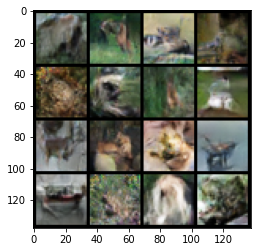

Num Iters: 97500 -- Discriminator--> Total Loss: 0.115, Real Loss: 0.112, Fake Loss: 0.117, Real Accuracy: 0.955, Fake accuracy: 0.965
Generator--> Total Loss: 4.236, Accuracy: 0.005



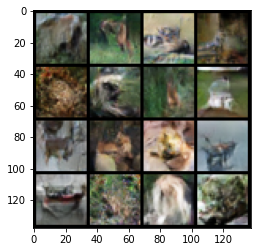

Num Iters: 98000 -- Discriminator--> Total Loss: 0.121, Real Loss: 0.118, Fake Loss: 0.124, Real Accuracy: 0.952, Fake accuracy: 0.962
Generator--> Total Loss: 4.202, Accuracy: 0.005



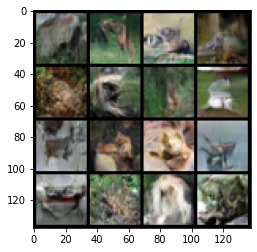

Num Iters: 98500 -- Discriminator--> Total Loss: 0.114, Real Loss: 0.111, Fake Loss: 0.117, Real Accuracy: 0.955, Fake accuracy: 0.963
Generator--> Total Loss: 4.326, Accuracy: 0.006



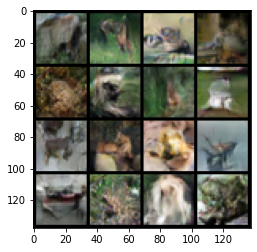

Num Iters: 99000 -- Discriminator--> Total Loss: 0.203, Real Loss: 0.184, Fake Loss: 0.223, Real Accuracy: 0.926, Fake accuracy: 0.940
Generator--> Total Loss: 4.102, Accuracy: 0.022



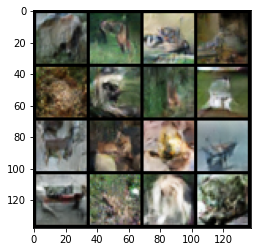

Num Iters: 99500 -- Discriminator--> Total Loss: 0.117, Real Loss: 0.114, Fake Loss: 0.119, Real Accuracy: 0.953, Fake accuracy: 0.961
Generator--> Total Loss: 4.331, Accuracy: 0.007



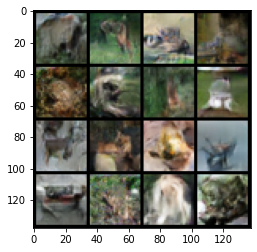

In [ ]:
trainGAN(models,opts,trackers,real_dl,fixed_noise=z,n_iters = 200*len(real_dl.dl))

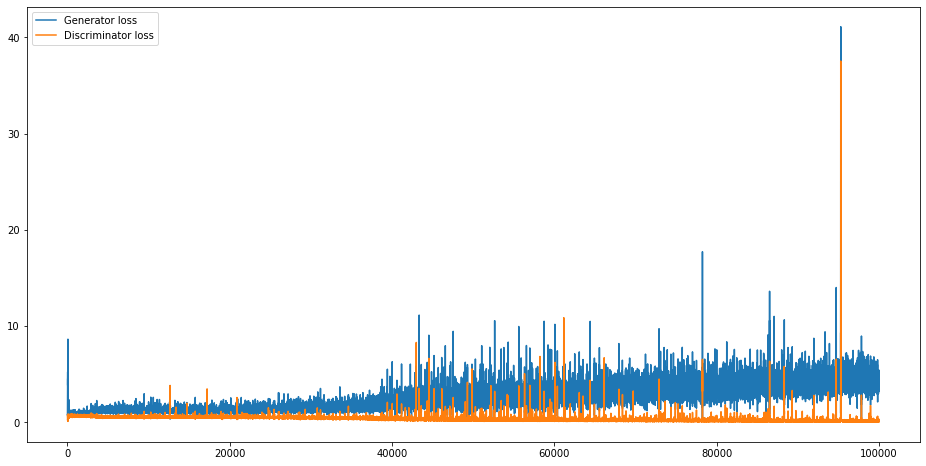

In [ ]:
plt.figure(figsize=(16,8))
plt.plot(trackers[0].losses,label='Generator loss')
plt.plot(trackers[1].losses,label='Discriminator loss')
plt.legend(loc='best')
_=plt.show()

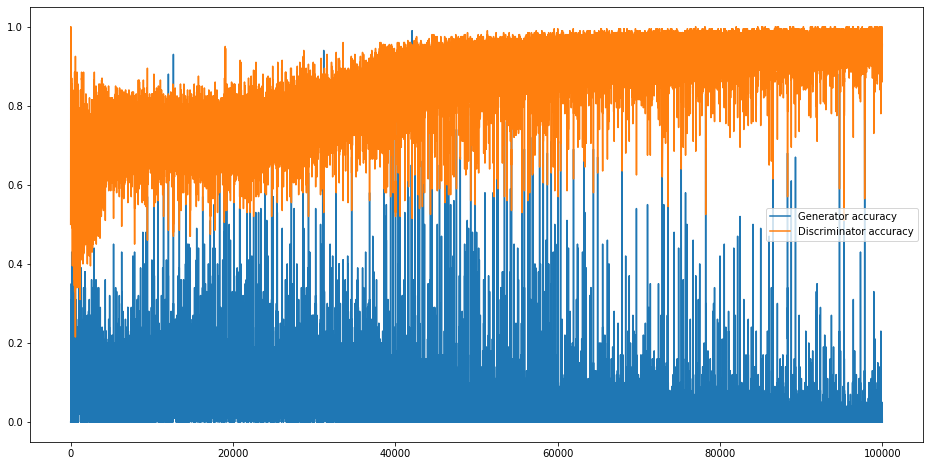

In [ ]:
plt.figure(figsize=(16,8))
plt.plot(trackers[0].accuracies,label='Generator accuracy')
plt.plot(trackers[1].accuracies,label='Discriminator accuracy')
plt.legend(loc='best')
_=plt.show()

In [ ]:
torch.save(gen_model.state_dict(),'./gen_model.pkl')

In [ ]:
torch.save(disc_model.state_dict(),'./disc_model.pkl')

In [ ]:
!cp gen_model.pkl /content/drive/My\ Drive/GANs/DCGAN/gen_model.pkl

In [ ]:
!cp disc_model.pkl /content/drive/My\ Drive/GANs/DCGAN/disc_model.pkl